<a href="https://colab.research.google.com/github/Murcha1990/ML_AI25/blob/main/Hometasks/Pro/AI_HW1_Regression_with_inference_pro_pt1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Домашнее задание №1 (pro). Часть 1**

В этом домашнем задании (его первой части) вам будет необходимо:
*  обучить модель регрессии для предсказания стоимости автомобилей;


> Оценка за первую часть домашки = $min(\text{ваш балл}, 7)$



**Примечание**

В каждой части оцениваются как код, **так и ответы на вопросы.** Вопросы подсвечены синим цветом.

Если нет одного и/или другого, то часть баллов за соответствующее задание снимается.

In [1]:
#!pip install ydata_profiling

In [2]:
#pip install category-encoders

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
import seaborn as sns

from sklearn.compose import ColumnTransformer, TransformedTargetRegressor
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer

from sklearn.preprocessing import StandardScaler, OneHotEncoder
from category_encoders import TargetEncoder

from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge
from sklearn.linear_model import ElasticNet

from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import KFold, cross_validate

from sklearn.metrics import r2_score, mean_squared_error as MSE
from sklearn.metrics import make_scorer

import random
import re
random.seed(42)
np.random.seed(42)
RANDOM_STATE=42

from ydata_profiling import ProfileReport
import phik

from itertools import combinations

import os
import pickle

### **Задание 0**
Давайте зафиксируем важный момент.

**Задание 0 (0 баллов).**
Изучите и ответье на вопрос: для чего фиксируем сиды в домашках?

`Your answer here:`

обеспечиваем воспроизводимость всех результатов при запуске кода

# **Часть 1 | EDA**


Первая часть состоит из классических шагов EDA:

- Базовый EDA и обработка признаков (1.7 балла)
- Визуализации признаков и их анализ (1.6 балл)

Всего можно набрать 3.3 основных балла и 0.25 бонусных.

В следующих частях, вы увидите бонусные задания. Бонусные задания выделены как **Дополнительное задание/Бонус**. Вы можете выполнять их, чтобы в случае ошибок в основных задачах всё равно набрать за работу максимум. Кроме того, дополнительные задания позволяют вам углубить знания.

Призываем активно использовать их!

## **Простейший EDA и обработка признаков (1.7 балла)**

In [4]:
df_train = pd.read_csv('https://raw.githubusercontent.com/Murcha1990/MLDS_ML_2022/main/Hometasks/HT1/cars_train.csv')
df_test = pd.read_csv('https://raw.githubusercontent.com/Murcha1990/MLDS_ML_2022/main/Hometasks/HT1/cars_test.csv')

print("Train data shape:", df_train.shape)
print("Test data shape: ", df_test.shape)

Train data shape: (6999, 13)
Test data shape:  (1000, 13)


In [5]:
df_train.head()

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
0,Maruti Swift Dzire VDI,2014,450000,145500,Diesel,Individual,Manual,First Owner,23.4 kmpl,1248 CC,74 bhp,190Nm@ 2000rpm,5.0
1,Skoda Rapid 1.5 TDI Ambition,2014,370000,120000,Diesel,Individual,Manual,Second Owner,21.14 kmpl,1498 CC,103.52 bhp,250Nm@ 1500-2500rpm,5.0
2,Hyundai i20 Sportz Diesel,2010,225000,127000,Diesel,Individual,Manual,First Owner,23.0 kmpl,1396 CC,90 bhp,22.4 kgm at 1750-2750rpm,5.0
3,Maruti Swift VXI BSIII,2007,130000,120000,Petrol,Individual,Manual,First Owner,16.1 kmpl,1298 CC,88.2 bhp,"11.5@ 4,500(kgm@ rpm)",5.0
4,Hyundai Xcent 1.2 VTVT E Plus,2017,440000,45000,Petrol,Individual,Manual,First Owner,20.14 kmpl,1197 CC,81.86 bhp,113.75nm@ 4000rpm,5.0


In [6]:
df_test.head()

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
0,Mahindra Xylo E4 BS IV,2010,229999,168000,Diesel,Individual,Manual,First Owner,14.0 kmpl,2498 CC,112 bhp,260 Nm at 1800-2200 rpm,7.0
1,Tata Nexon 1.5 Revotorq XE,2017,665000,25000,Diesel,Individual,Manual,First Owner,21.5 kmpl,1497 CC,108.5 bhp,260Nm@ 1500-2750rpm,5.0
2,Honda Civic 1.8 S AT,2007,175000,218463,Petrol,Individual,Automatic,First Owner,12.9 kmpl,1799 CC,130 bhp,172Nm@ 4300rpm,5.0
3,Honda City i DTEC VX,2015,635000,173000,Diesel,Individual,Manual,First Owner,25.1 kmpl,1498 CC,98.6 bhp,200Nm@ 1750rpm,5.0
4,Tata Indica Vista Aura 1.2 Safire BSIV,2011,130000,70000,Petrol,Individual,Manual,Second Owner,16.5 kmpl,1172 CC,65 bhp,96 Nm at 3000 rpm,5.0


In [7]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6999 entries, 0 to 6998
Data columns (total 13 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   name           6999 non-null   object 
 1   year           6999 non-null   int64  
 2   selling_price  6999 non-null   int64  
 3   km_driven      6999 non-null   int64  
 4   fuel           6999 non-null   object 
 5   seller_type    6999 non-null   object 
 6   transmission   6999 non-null   object 
 7   owner          6999 non-null   object 
 8   mileage        6797 non-null   object 
 9   engine         6797 non-null   object 
 10  max_power      6803 non-null   object 
 11  torque         6796 non-null   object 
 12  seats          6797 non-null   float64
dtypes: float64(1), int64(3), object(9)
memory usage: 711.0+ KB


In [8]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 13 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   name           1000 non-null   object 
 1   year           1000 non-null   int64  
 2   selling_price  1000 non-null   int64  
 3   km_driven      1000 non-null   int64  
 4   fuel           1000 non-null   object 
 5   seller_type    1000 non-null   object 
 6   transmission   1000 non-null   object 
 7   owner          1000 non-null   object 
 8   mileage        981 non-null    object 
 9   engine         981 non-null    object 
 10  max_power      981 non-null    object 
 11  torque         981 non-null    object 
 12  seats          981 non-null    float64
dtypes: float64(1), int64(3), object(9)
memory usage: 101.7+ KB


**Промежуточный вывод**

- есть пропуски в 5 столбцах
- нужно преобразовать тип данных числовых признаков `mileage`, `engine`, `max_power` и `torque`, убрав нечисловые символы из ячеек
- преобразуем также `seats` в int после заполнения пропусков

### **Задание 1.(0.4 балла)**
Выполните операции, направленные на базовое исследование данных:

- [x] Посмотрите, есть ли в датасете пропуски и дубликаты. Запишите/выведите названия колонок, для которых есть пропущенные значения (0.1 балла)
- [x] Посмотрите, есть ли в данных явные дубликаты (0.05 балла)
- [x] Постройте дашборд в одну строку, используя [ydata-profilling](https://github.com/ydataai/ydata-profiling)(0.15 балла)
- [x] Опишите базовые выводы (какие — выберите сами), используя дашборд (0.2 балла).

**NB!** Я тут сразу перед построением дашборда обработала столбцы (**задание 4**)

In [9]:
 df_train.isna().sum()

name               0
year               0
selling_price      0
km_driven          0
fuel               0
seller_type        0
transmission       0
owner              0
mileage          202
engine           202
max_power        196
torque           203
seats            202
dtype: int64

In [10]:
round((df_train.isnull().sum() / len(df_train)) * 100, 2)

name             0.00
year             0.00
selling_price    0.00
km_driven        0.00
fuel             0.00
seller_type      0.00
transmission     0.00
owner            0.00
mileage          2.89
engine           2.89
max_power        2.80
torque           2.90
seats            2.89
dtype: float64

In [11]:
df_test.isna().sum()

name              0
year              0
selling_price     0
km_driven         0
fuel              0
seller_type       0
transmission      0
owner             0
mileage          19
engine           19
max_power        19
torque           19
seats            19
dtype: int64

In [12]:
round((df_test.isnull().sum() / len(df_test)) * 100, 2)

name             0.0
year             0.0
selling_price    0.0
km_driven        0.0
fuel             0.0
seller_type      0.0
transmission     0.0
owner            0.0
mileage          1.9
engine           1.9
max_power        1.9
torque           1.9
seats            1.9
dtype: float64

In [13]:
sum(df_train.duplicated())

985

In [14]:
sum(df_test.duplicated())

62

**Промежуточные выводы**
- Пропуски есть в датасете train и test в тех же 5 колонках, где планируем изменять тип данных: `mileage`, `engine`, `max_power`, `torque`, `seats`
- пропуски составляют до 3% от датасета
- в датасете с обучающей выборкой есть **985** явных дубликатов, в датасете с тестовой выборкой **62**

Обработаем сначала будущие числовые признаки, учетем наличие в них пропусков

рассмотрим сначала значения, а затем изменим данные:

In [15]:
df_train['max_power'].unique()

array(['74 bhp', '103.52 bhp', '90 bhp', '88.2 bhp', '81.86 bhp',
       '57.5 bhp', '37 bhp', '67.1 bhp', '68.1 bhp', '108.45 bhp',
       '60 bhp', '73.9 bhp', nan, '67 bhp', '82 bhp', '46.3 bhp',
       '88.73 bhp', '64.1 bhp', '98.6 bhp', '88.8 bhp', '83.1 bhp',
       '47.3 bhp', '73.8 bhp', '34.2 bhp', '88.5 bhp', '35 bhp',
       '40.3 bhp', '121.3 bhp', '138.03 bhp', '160.77 bhp', '117.3 bhp',
       '116.3 bhp', '67.05 bhp', '168.5 bhp', '100 bhp', '120.7 bhp',
       '98.63 bhp', '175.56 bhp', '171.5 bhp', '100.6 bhp', '174.33 bhp',
       '187.74 bhp', '170 bhp', '78.9 bhp', '88.76 bhp', '86.8 bhp',
       '108.495 bhp', '108.62 bhp', '93.7 bhp', '103.6 bhp', '98.59 bhp',
       '189 bhp', '67.04 bhp', '68.05 bhp', '58.2 bhp', '82.85 bhp',
       '81.80 bhp', '120 bhp', '94.68 bhp', '160 bhp', '155 bhp',
       '69.01 bhp', '126.32 bhp', '138.1 bhp', '83.14 bhp', '83.8 bhp',
       '126.2 bhp', '62.1 bhp', '86.7 bhp', '188 bhp', '214.56 bhp',
       '177 bhp', '148.31 bhp', 

In [16]:
df_train['max_power'].nunique()

316

In [17]:
count = 0
for i in df_train['max_power'].unique():
    if pd.isna(i):
        continue
    elif 'bhp' in i:
        count +=1
    else:
        print(i)
print(count)

0
315


In [18]:
print(df_test['max_power'].nunique())

count = 0
for i in df_test['max_power'].unique():
    if pd.isna(i):
        continue
    elif 'bhp' in i:
        count +=1
    else:
        print(i)
print(count)

182
182


Таким образом, единицы измерения в данном столбце только в bhp - Brake Horsepower

In [19]:
df_train['engine'].unique()

array(['1248 CC', '1498 CC', '1396 CC', '1298 CC', '1197 CC', '1061 CC',
       '796 CC', '1364 CC', '1399 CC', '1461 CC', '993 CC', nan,
       '1198 CC', '998 CC', '1591 CC', '2179 CC', '1368 CC', '1497 CC',
       '2982 CC', '2494 CC', '2143 CC', '2477 CC', '2755 CC', '1968 CC',
       '1196 CC', '1373 CC', '1598 CC', '1998 CC', '1086 CC', '1194 CC',
       '1798 CC', '1405 CC', '1582 CC', '999 CC', '2487 CC', '1999 CC',
       '2987 CC', '1995 CC', '1451 CC', '1969 CC', '2967 CC', '2497 CC',
       '1797 CC', '1991 CC', '2362 CC', '1493 CC', '1341 CC', '1199 CC',
       '1794 CC', '1193 CC', '2696 CC', '799 CC', '1495 CC', '1186 CC',
       '1047 CC', '2498 CC', '2523 CC', '1120 CC', '624 CC', '1496 CC',
       '1984 CC', '2354 CC', '793 CC', '1799 CC', '936 CC', '1956 CC',
       '814 CC', '1997 CC', '1948 CC', '2997 CC', '1172 CC', '2489 CC',
       '2499 CC', '2609 CC', '2953 CC', '1150 CC', '1994 CC', '1388 CC',
       '1462 CC', '2956 CC', '1527 CC', '2199 CC', '995 CC', '1599

In [20]:
df_test['engine'].unique()

array(['2498 CC', '1497 CC', '1799 CC', '1498 CC', '1172 CC', '995 CC',
       '1197 CC', '796 CC', '1582 CC', '2487 CC', '1196 CC', '3604 CC',
       '1373 CC', '1405 CC', '1495 CC', '1248 CC', '998 CC', '624 CC',
       '2179 CC', '1120 CC', '1396 CC', '1461 CC', '2494 CC', '1596 CC',
       nan, '1198 CC', '1086 CC', '1399 CC', '1598 CC', '2523 CC',
       '1199 CC', '814 CC', '1298 CC', '999 CC', '1496 CC', '1995 CC',
       '799 CC', '1984 CC', '936 CC', '2755 CC', '1586 CC', '1364 CC',
       '2956 CC', '993 CC', '1493 CC', '1186 CC', '1991 CC', '1969 CC',
       '1194 CC', '2982 CC', '2499 CC', '1999 CC', '1047 CC', '1798 CC',
       '1968 CC', '1997 CC', '2993 CC', '1499 CC', '1591 CC', '1150 CC',
       '2143 CC', '1061 CC', '1193 CC', '2393 CC', '1797 CC', '2835 CC',
       '1597 CC', '2497 CC', '1599 CC', '1794 CC', '3198 CC', '2987 CC',
       '1388 CC', '1956 CC', '2477 CC', '2609 CC', '1998 CC', '1948 CC',
       '909 CC', '1462 CC', '1341 CC', '1368 CC', '2953 CC', '2696

Из engine нужно убрать только буквы СС - Cubic Capacity

In [21]:
df_train['mileage'].unique()[:10]

array(['23.4 kmpl', '21.14 kmpl', '23.0 kmpl', '16.1 kmpl', '20.14 kmpl',
       '17.3 km/kg', '23.59 kmpl', '20.0 kmpl', '19.01 kmpl', '17.3 kmpl'],
      dtype=object)

есть как минимум два вида единиц измерения в данном столбце - наименьшее: km/kg, переведем их в kmpl, но сначала посмотрим на количество

In [22]:
kmkg = 0
kmpl = 0
other = 0
for i in df_train['mileage']:
    if str(i).endswith('km/kg'):
        kmkg+=1
    elif str(i).endswith('kmpl'):
        kmpl+=1
    else:
        other+=1
print('rows with km/kg:', kmkg)
print('rows with kmpl:', kmpl)
print('rows with other ending:', other)

rows with km/kg: 79
rows with kmpl: 6718
rows with other ending: 202


In [23]:
kmkg = 0
kmpl = 0
other = 0
for i in df_test['mileage']:
    if str(i).endswith("km/kg"):
        kmkg+=1
    elif str(i).endswith("kmpl"):
        kmpl+=1
    else:
        other+=1
print('rows with km/kg:', kmkg)
print('rows with kmpl:', kmpl)
print('rows with other ending:', other)

rows with km/kg: 9
rows with kmpl: 972
rows with other ending: 19


другие окончания совпадают с количеством пропусков, значит в данных ячейках nan

поиск в интернете подсказывает, что 1 km/kg becomes about 0.75 kmpl for petrol и 0.85 for diesel, так как petrol является наиболее распространенным видом топлива, будем переводить значения, умножая на 0.75 

In [24]:
df_train['torque'].unique()

array(['190Nm@ 2000rpm', '250Nm@ 1500-2500rpm',
       '22.4 kgm at 1750-2750rpm', '11.5@ 4,500(kgm@ rpm)',
       '113.75nm@ 4000rpm', '7.8@ 4,500(kgm@ rpm)', '59Nm@ 2500rpm',
       '170Nm@ 1800-2400rpm', '160Nm@ 2000rpm', '248Nm@ 2250rpm',
       '78Nm@ 4500rpm', nan, '84Nm@ 3500rpm', '115Nm@ 3500-3600rpm',
       '62Nm@ 3000rpm', '219.7Nm@ 1500-2750rpm', '200Nm@ 1750rpm',
       '115Nm@ 4000rpm', '69Nm@ 3500rpm', '172.5Nm@ 1750rpm',
       '6.1kgm@ 3000rpm', '60Nm@ 3500rpm', '90Nm@ 3500rpm',
       '151Nm@ 4850rpm', '104Nm@ 4000rpm', '320Nm@ 1700-2700rpm',
       '250Nm@ 1750-2500rpm', '145Nm@ 4600rpm', '146Nm@ 4800rpm',
       '343Nm@ 1400-3400rpm', '200Nm@ 1400-3400rpm',
       '200Nm@ 1250-4000rpm', '400Nm@ 2000-2500rpm',
       '360Nm@ 1200-3400rpm', '200Nm@ 1200-3600rpm',
       '380Nm@ 1750-2500rpm', '400Nm@ 1750-3000rpm',
       '400Nm@ 1400-2800rpm', '200Nm@ 1750-3000rpm', '111.7Nm@ 4000rpm',
       '219.6Nm@ 1500-2750rpm', '112Nm@ 4000rpm', '250Nm@ 1500-3000rpm',
       '1

In [25]:
df_test['torque'].unique()

array(['260 Nm at 1800-2200 rpm', '260Nm@ 1500-2750rpm', '172Nm@ 4300rpm',
       '200Nm@ 1750rpm', '96  Nm at 3000  rpm ', '247Nm@ 1800-2000rpm',
       '90.3Nm@ 4200rpm', '114Nm@ 4000rpm', '62Nm@ 3000rpm',
       '259.9Nm@ 1900-2750rpm', '259.87nm@ 1500-3000rpm',
       '202Nm@ 3600-5200rpm', '111.7Nm@ 4000rpm', '112Nm@ 4000rpm',
       '347Nm@ 4300rpm', '130Nm@ 4000rpm', '135.4Nm@ 2500rpm',
       '11.4 kgm at 4,000 rpm', '124.6Nm@ 3500rpm', '190Nm@ 2000rpm',
       '90Nm@ 3500rpm', '51Nm@ 4000rpm', '215Nm@ 1750-3000rpm',
       '330Nm@ 1600-2800rpm', '160Nm@ 1500-2750rpm',
       '219.66nm@ 1500-2750rpm', '300Nm@ 1750-2500rpm', '245Nm@ 1750rpm',
       '20.4@ 1400-3400(kgm@ rpm)', '146Nm@ 3400rpm', nan,
       '109Nm@ 4500rpm', '99Nm@ 4500rpm', '190Nm@ 1750-3000rpm',
       '131Nm@ 4400rpm', '153Nm@ 3800rpm', '135Nm@ 2500rpm',
       '159.8Nm@ 1500-2750rpm', '77Nm@ 3500rpm', '195Nm@ 1400-2200rpm',
       '180Nm@ 2000rpm', '111.8Nm@ 4000rpm', '101Nm@ 3000rpm',
       '110Nm@ 4800rpm

Ужасный столбец)) 

**Проблемы:**
1. в одном столбце даны 2 показателя - крутящий момент (Nm/kgm) и обороты в минуту(rpm), при которых достигается максимальный момент: разделим числовые значения на 2 столбца
2. бывает указан диапазон оборотов в минуту - плато, при котором достигается максимальный крутящий, тогда во второй столбец будем записывать среднее значение диапазона
3. есть значения, где указан только один из показателей, например, `480Nm` - нужно будет указать nan во втором столбце
4. разные единицы измерения для крутящего момента - в Ньютонах на метр и в кг на метр - будем приводить все в Nm: 1 kgm = 9.80665 Nm
5. единицы измерения для крутящего момента могут быть указаны после значения оборотов в минуту, единицы измерения могут быть опущены в принципе
6. могут быть укзаны значения крутящего момента в обеих единицах измерения `380Nm(38.7kgm)@ 2500rpm`
7. разный регистр
8. тысячи отделены запятыми
9. разные разделители: @, at, /, пробелы, +/-, встречаются скобки
10. есть опечатки: `400Nm@ 175-2750rpm`

**Обработка данных**

In [26]:
def to_num(df, col, num):
    for i in range(0, len(df)):
        try:
            ffil_value = float(df.loc[i, col][:num])
            df.loc[i, col] = ffil_value
        except:
            if df.loc[i, col] in [np.nan, 'nan']:
                continue
            elif df.loc[i, col] == '0':
                ffil_value = float(df.loc[i, col])
                df.loc[i, col] = ffil_value
            else:
                df.loc[i, col] = 0

In [27]:
to_num(df_train, 'max_power', -4)
df_train['max_power'] = df_train['max_power'].astype('float')

In [28]:
to_num(df_test, 'max_power', -4)
df_test['max_power'] = df_test['max_power'].astype('float')

In [29]:
to_num(df_train, 'engine', -3)
df_train['engine'] = df_train['engine'].astype('float')

In [30]:
to_num(df_test, 'engine', -3)
df_test['engine'] = df_test['engine'].astype('float')

In [31]:
def for_mil(val):
    if pd.isna(val):
        return val
    elif val.endswith('km/kg'):
        val = float(val[:-6]) *0.75
        return val
    elif val.endswith('kmpl'):
        val = float(val[:-6])
        return val
    else:
        return val

In [32]:
df_train['mileage'] = df_train['mileage'].apply(for_mil)
df_test['mileage'] = df_test['mileage'].apply(for_mil)

In [33]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6999 entries, 0 to 6998
Data columns (total 13 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   name           6999 non-null   object 
 1   year           6999 non-null   int64  
 2   selling_price  6999 non-null   int64  
 3   km_driven      6999 non-null   int64  
 4   fuel           6999 non-null   object 
 5   seller_type    6999 non-null   object 
 6   transmission   6999 non-null   object 
 7   owner          6999 non-null   object 
 8   mileage        6797 non-null   float64
 9   engine         6797 non-null   float64
 10  max_power      6803 non-null   float64
 11  torque         6796 non-null   object 
 12  seats          6797 non-null   float64
dtypes: float64(4), int64(3), object(6)
memory usage: 711.0+ KB


In [34]:
df_test.head()

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
0,Mahindra Xylo E4 BS IV,2010,229999,168000,Diesel,Individual,Manual,First Owner,14.0,2498.0,112.0,260 Nm at 1800-2200 rpm,7.0
1,Tata Nexon 1.5 Revotorq XE,2017,665000,25000,Diesel,Individual,Manual,First Owner,21.0,1497.0,108.5,260Nm@ 1500-2750rpm,5.0
2,Honda Civic 1.8 S AT,2007,175000,218463,Petrol,Individual,Automatic,First Owner,12.0,1799.0,130.0,172Nm@ 4300rpm,5.0
3,Honda City i DTEC VX,2015,635000,173000,Diesel,Individual,Manual,First Owner,25.0,1498.0,98.6,200Nm@ 1750rpm,5.0
4,Tata Indica Vista Aura 1.2 Safire BSIV,2011,130000,70000,Petrol,Individual,Manual,Second Owner,16.0,1172.0,65.0,96 Nm at 3000 rpm,5.0


В столбцах данные были приведены к числовым, теперь остался столбец `torque`, значения разделим на 2 столбца: для крутящего момента и для числа оборотов в минуту при максимальном моменте:

In [35]:
#эта часть сделана при помощи llm, прости господи
kgm_to_nm = 9.80665

# вынесеме regex в константы (ускоряет на больших данных)
RE_NM  = re.compile(r"([0-9]*\.?[0-9]+)\s*(?:n\s*m|nm)\b")
RE_KGM = re.compile(r"([0-9]*\.?[0-9]+)\s*kgm\b")
RE_BEFORE_SEP = re.compile(r"([0-9]*\.?[0-9]+)\s*(?:@| at |/)\s*")
RE_FIRST_NUM  = re.compile(r"([0-9]*\.?[0-9]+)")

RE_RANGE = re.compile(r"(\d+(?:\.\d+)?)\s*-\s*(\d+(?:\.\d+)?)")
RE_PM    = re.compile(r"(\d+(?:\.\d+)?)\s*\+/-\s*(\d+(?:\.\d+)?)")

In [36]:
def _normalize_text(s: str) -> str:
    txt = str(s).strip().lower()
    txt = txt.replace(",", "")
    txt = txt.replace("—", "-").replace("–", "-")
    txt = txt.replace("~", "-")
    txt = re.sub(r"\s+", " ", txt)
    return txt

def _fix_suspicious_rpm_range_low(a: float, b: float, rpm_min: float = 500.0) -> float:
    if np.isnan(a) or np.isnan(b):
        return a
    if a <= 0 or b <= 0:
        return a
    if b < a:
        a, b = b, a

    a_int = int(round(a))
    b_int = int(round(b))

    # 175-2750 -> 1750-2750
    if a < rpm_min and b >= 1000 and len(str(a_int)) == 3 and len(str(b_int)) == 4 and (b / a) > 5:
        return a * 10
    return a

In [37]:
def parse_torque_value(s: str):
    if s is None or (isinstance(s, float) and np.isnan(s)):
        return np.nan, np.nan

    txt = _normalize_text(s)
    if not txt:
        return np.nan, np.nan

    # ---------- TORQUE ----------
    torque_nm = np.nan

    m = RE_NM.search(txt)
    if m:
        torque_nm = float(m.group(1))
    else:
        # Явный kgm рядом с числом (например "22.4 kgm at ...") — это действительно kgm
        m = RE_KGM.search(txt)
        if m:
            torque_nm = float(m.group(1)) * kgm_to_nm
        else:
            # Берём число до разделителя (@/at//) или первое число
            m = RE_BEFORE_SEP.search(txt) or RE_FIRST_NUM.search(txt)
            if m:
                val = float(m.group(1))

                #"слово kgm есть, но это мусор, а val>100 => считаем Nm
                if ("kgm" in txt) and (val > 100):
                    torque_nm = val
                else:
                    torque_nm = val * kgm_to_nm if ("kgm" in txt) else val

    # ---------- RPM ----------
    rpm_val = np.nan

    parts = re.split(r"\s*(?:@| at |/)\s*", txt, maxsplit=1)
    tail = parts[1] if len(parts) > 1 else ""

    # чистим скобки и мусор
    tail_clean = re.sub(r"\([^)]*\)", " ", tail)
    tail_clean = re.sub(r"\s+", " ", tail_clean).strip()

    m = RE_RANGE.search(tail_clean)
    if m:
        a = float(m.group(1))
        b = float(m.group(2))
        a = _fix_suspicious_rpm_range_low(a, b, rpm_min=500.0)
        rpm_val = (a + b) / 2.0
    else:
        m = RE_PM.search(tail_clean)
        if m:
            rpm_val = float(m.group(1))
        else:
            m = RE_FIRST_NUM.search(tail_clean)
            if m:
                rpm_val = float(m.group(1))

    return torque_nm, rpm_val

In [38]:
def sanity_check_row(raw: str, torque_nm: float, rpm: float,
                     rpm_min=500, rpm_max=9000,
                     tq_min=30, tq_max=700):
    """
    Возвращает: suspect (bool), suspect_reason (str)
    """
    reasons = []

    if raw is None or (isinstance(raw, float) and np.isnan(raw)):
        reasons.append("raw_missing")
    else:
        raw_txt = str(raw).lower().replace(",", "")
        if re.search(r"\b\d{3}\s*-\s*\d{4}\b", raw_txt):
            reasons.append("rpm_range_low_typo_pattern")

    if np.isnan(torque_nm):
        reasons.append("torque_missing")
    else:
        if torque_nm < tq_min:
            reasons.append(f"torque_too_low<{tq_min}")
        if torque_nm > tq_max:
            reasons.append(f"torque_too_high>{tq_max}")

    if np.isnan(rpm):
        reasons.append("rpm_missing")
    else:
        if rpm < rpm_min:
            reasons.append(f"rpm_too_low<{rpm_min}")
        if rpm > rpm_max:
            reasons.append(f"rpm_too_high>{rpm_max}")
    # Доп. эвристика: явно подозрительная "трёхзначная rpm" (частая опечатка 175 вместо 1750)
    if not np.isnan(rpm) and (100 <= rpm < 500):
        reasons.append("rpm_3digits_possible_typo")

    suspect = len(reasons) > 0
    return suspect, ";".join(reasons)

In [39]:
parsed = df_train['torque'].apply(lambda x: pd.Series(parse_torque_value(x), index=['torque_nm', 'max_torque_rpm']))
df_train = pd.concat([df_train, parsed], axis=1)

parsed = df_test['torque'].apply(lambda x: pd.Series(parse_torque_value(x), index=['torque_nm', 'max_torque_rpm']))
df_test = pd.concat([df_test, parsed], axis=1)

In [40]:
checks = df_train.apply(lambda r: pd.Series(
    sanity_check_row(r['torque'], r['torque_nm'], r['max_torque_rpm']),
    index=['suspect', 'suspect_reason']
), axis=1)

df_train = pd.concat([df_train, checks], axis=1)

In [41]:
df_train[(df_train['suspect'] == 1) & ~(df_train['torque'].isna())]

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats,torque_nm,max_torque_rpm,suspect,suspect_reason
129,Volvo XC40 D4 R-Design,2018,3400000,22000,Diesel,Dealer,Automatic,First Owner,18.0,1969.0,190.0,400Nm,5.0,400.0,NaN,True,rpm_missing
361,Volvo XC40 D4 Inscription BSIV,2019,3800000,20000,Diesel,Individual,Automatic,First Owner,18.0,1969.0,190.0,400Nm,5.0,400.0,NaN,True,rpm_missing
567,Volvo XC40 D4 Inscription BSIV,2019,3800000,20000,Diesel,Individual,Automatic,First Owner,18.0,1969.0,190.0,400Nm,5.0,400.0,NaN,True,rpm_missing
820,Maruti Zen D,2003,85000,120000,Diesel,Individual,Manual,Third Owner,20.0,1527.0,58.0,789Nm@ 2250rpm,5.0,789.0,2250.0,True,torque_too_high>700
929,Volvo XC40 D4 Inscription BSIV,2019,3800000,20000,Diesel,Individual,Automatic,First Owner,18.0,1969.0,190.0,400Nm,5.0,400.0,NaN,True,rpm_missing
947,Volvo XC40 D4 Inscription BSIV,2019,3800000,20000,Diesel,Individual,Automatic,First Owner,18.0,1969.0,190.0,400Nm,5.0,400.0,NaN,True,rpm_missing
962,Volvo XC40 D4 Inscription BSIV,2019,3800000,20000,Diesel,Individual,Automatic,First Owner,18.0,1969.0,190.0,400Nm,5.0,400.0,NaN,True,rpm_missing
978,Volvo XC40 D4 Inscription BSIV,2019,3800000,20000,Diesel,Individual,Automatic,First Owner,18.0,1969.0,190.0,400Nm,5.0,400.0,NaN,True,rpm_missing
1468,Volvo XC40 D4 Inscription BSIV,2019,3800000,20000,Diesel,Individual,Automatic,First Owner,18.0,1969.0,190.0,400Nm,5.0,400.0,NaN,True,rpm_missing
1568,Volvo XC40 D4 Inscription BSIV,2019,3800000,20000,Diesel,Individual,Automatic,First Owner,18.0,1969.0,190.0,400Nm,5.0,400.0,NaN,True,rpm_missing


In [42]:
idx = df_train.index[df_train['torque'] == '400Nm']
len(idx)

28

In [43]:
df_train.loc[idx, 'max_torque_rpm'] = np.nan
df_train.loc[idx, 'suspect'] = False

In [44]:
df_train[(df_train['suspect'] == 1) & ~(df_train['torque'].isna())]

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats,torque_nm,max_torque_rpm,suspect,suspect_reason
820,Maruti Zen D,2003,85000,120000,Diesel,Individual,Manual,Third Owner,20.0,1527.0,58.0,789Nm@ 2250rpm,5.0,789.0,2250.0,True,torque_too_high>700
4032,Maruti Zen D,2002,120000,60000,Diesel,Individual,Manual,Second Owner,20.0,1527.0,58.0,789Nm@ 2250rpm,5.0,789.0,2250.0,True,torque_too_high>700
4398,Maruti Zen D,2006,80000,110000,Diesel,Individual,Manual,Second Owner,20.0,1527.0,58.0,789Nm@ 2250rpm,5.0,789.0,2250.0,True,torque_too_high>700
4633,Tata Sumo EX TC,2005,225000,188000,Diesel,Individual,Manual,First Owner,12.0,1948.0,90.0,"190@ 21,800(kgm@ rpm)",7.0,190.0,21800.0,True,rpm_too_high>9000


- данные строки были выделены из-за опечаток
- согласно доступной информации по модели машины Tata Sumo EX TC ее обороты в минуту составляются 1800 rpm, 2 является опечаткой
- согласно данным по машине Maruti Zen D е torque_nm составляет 78, тогда как 9 была добавлена случайно как рядом стоящая цифра  

In [45]:
m = df_train.index[(df_train['max_power'] == 58) & (df_train['suspect'] == True)]
df_train.loc[m, 'torque_nm'] = 78

df_train.loc[4633, 'max_torque_rpm'] = 1800

In [46]:
df_train = df_train.drop(['suspect', 'suspect_reason'], axis=1)

In [47]:
display(df_train.head())
df_train.info()

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats,torque_nm,max_torque_rpm
0,Maruti Swift Dzire VDI,2014,450000,145500,Diesel,Individual,Manual,First Owner,23.0,1248.0,74.00,190Nm@ 2000rpm,5.0,190.000000,2000.0
1,Skoda Rapid 1.5 TDI Ambition,2014,370000,120000,Diesel,Individual,Manual,Second Owner,21.1,1498.0,103.52,250Nm@ 1500-2500rpm,5.0,250.000000,2000.0
2,Hyundai i20 Sportz Diesel,2010,225000,127000,Diesel,Individual,Manual,First Owner,23.0,1396.0,90.00,22.4 kgm at 1750-2750rpm,5.0,219.668960,2250.0
3,Maruti Swift VXI BSIII,2007,130000,120000,Petrol,Individual,Manual,First Owner,16.0,1298.0,88.20,"11.5@ 4,500(kgm@ rpm)",5.0,112.776475,4500.0
4,Hyundai Xcent 1.2 VTVT E Plus,2017,440000,45000,Petrol,Individual,Manual,First Owner,20.1,1197.0,81.86,113.75nm@ 4000rpm,5.0,113.750000,4000.0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6999 entries, 0 to 6998
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   name            6999 non-null   object 
 1   year            6999 non-null   int64  
 2   selling_price   6999 non-null   int64  
 3   km_driven       6999 non-null   int64  
 4   fuel            6999 non-null   object 
 5   seller_type     6999 non-null   object 
 6   transmission    6999 non-null   object 
 7   owner           6999 non-null   object 
 8   mileage         6797 non-null   float64
 9   engine          6797 non-null   float64
 10  max_power       6803 non-null   float64
 11  torque          6796 non-null   object 
 12  seats           6797 non-null   float64
 13  torque_nm       6796 non-null   float64
 14  max_torque_rpm  6768 non-null   float64
dtypes: float64(6), int64(3), object(6)
memory usage: 820.3+ KB


**Проверим тестовую выборку**

In [48]:
checks = df_test.apply(lambda r: pd.Series(
    sanity_check_row(r['torque'], r['torque_nm'], r['max_torque_rpm']),
    index=['suspect', 'suspect_reason']
), axis=1)

df_test = pd.concat([df_test, checks], axis=1)
df_test[(df_test['suspect'] == 1) & ~(df_test['torque'].isna())]

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats,torque_nm,max_torque_rpm,suspect,suspect_reason
148,Volvo XC40 D4 Inscription BSIV,2019,3800000,20000,Diesel,Individual,Automatic,First Owner,18.0,1969.0,190.0,400Nm,5.0,400.0,NaN,True,rpm_missing
440,Volvo XC40 D4 Inscription BSIV,2019,3800000,20000,Diesel,Individual,Automatic,First Owner,18.0,1969.0,190.0,400Nm,5.0,400.0,NaN,True,rpm_missing
865,Volvo XC40 D4 R-Design,2018,3400000,22000,Diesel,Dealer,Automatic,First Owner,18.0,1969.0,190.0,400Nm,5.0,400.0,NaN,True,rpm_missing
880,Volvo XC60 Inscription D5 BSIV,2018,5500000,50000,Diesel,Individual,Automatic,First Owner,11.0,1969.0,235.0,480Nm,5.0,480.0,NaN,True,rpm_missing


Встречаются те же проблемы, что и в прошлом датасете, исправим их

In [49]:
mask = df_test.index[(df_test['torque'] == '400Nm') | (df_test['torque'] == '480Nm')]
df_test.loc[mask, 'max_torque_rpm'] = np.nan

In [50]:
df_test = df_test.drop(['suspect', 'suspect_reason'], axis=1)

In [51]:
display(df_test.head())
df_test.info()

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats,torque_nm,max_torque_rpm
0,Mahindra Xylo E4 BS IV,2010,229999,168000,Diesel,Individual,Manual,First Owner,14.0,2498.0,112.0,260 Nm at 1800-2200 rpm,7.0,260.0,2000.0
1,Tata Nexon 1.5 Revotorq XE,2017,665000,25000,Diesel,Individual,Manual,First Owner,21.0,1497.0,108.5,260Nm@ 1500-2750rpm,5.0,260.0,2125.0
2,Honda Civic 1.8 S AT,2007,175000,218463,Petrol,Individual,Automatic,First Owner,12.0,1799.0,130.0,172Nm@ 4300rpm,5.0,172.0,4300.0
3,Honda City i DTEC VX,2015,635000,173000,Diesel,Individual,Manual,First Owner,25.0,1498.0,98.6,200Nm@ 1750rpm,5.0,200.0,1750.0
4,Tata Indica Vista Aura 1.2 Safire BSIV,2011,130000,70000,Petrol,Individual,Manual,Second Owner,16.0,1172.0,65.0,96 Nm at 3000 rpm,5.0,96.0,3000.0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   name            1000 non-null   object 
 1   year            1000 non-null   int64  
 2   selling_price   1000 non-null   int64  
 3   km_driven       1000 non-null   int64  
 4   fuel            1000 non-null   object 
 5   seller_type     1000 non-null   object 
 6   transmission    1000 non-null   object 
 7   owner           1000 non-null   object 
 8   mileage         981 non-null    float64
 9   engine          981 non-null    float64
 10  max_power       981 non-null    float64
 11  torque          981 non-null    object 
 12  seats           981 non-null    float64
 13  torque_nm       981 non-null    float64
 14  max_torque_rpm  977 non-null    float64
dtypes: float64(6), int64(3), object(6)
memory usage: 117.3+ KB


In [52]:
train_torque = df_train.copy()
test_torque = df_test.copy()

df_train = df_train.drop('torque', axis=1)
df_test = df_test.drop('torque', axis=1)

#### Дашбордs

In [53]:
report_train = ProfileReport(df_train, title='Train dataset dashbord')
report_test = ProfileReport(df_test, title='Test dataset dashbord')

In [54]:
report_train

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


%|                                                                                           | 0/14 [00:00<?, ?it/s]
100%|█████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 106.61it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [55]:
report_test

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


%|                                                                                           | 0/14 [00:00<?, ?it/s]
100%|█████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 117.81it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

**Выводы по дашбордам**

- нужно будет обработать:
    - явные дубли, посмотреть есть ли неявные дубли
    - пропуски
    - возвможно, выделить из name название марки и модели автомобиля и сделать этот столбец категориальным
- изменить тип данных в строках:
    - `seats`, `engine`, `max_torque_rpm` -> int
    - `fuel`, `seller_type`, `transmission`, `owner` -> category
- особенности в данных:
    - большинство данных о машинах после 2010 года, слева на графиках видим "хвост"
    - есть сильно выделяющиеся значения в цене машины: или выбросы (неправильно указанная цена, нереальная), или машины другой ценовой категории (премиум, спортивные машины, раритетные)
    - дизельные машиные встречаются чаще, чем на бензине (неожиданно), машины на газе редкие (ожидаемо)
    - большой перевес в `seller_type` - подавляющиее большинство продавцов Indiviual
    - есть два пика в `engine`: примерно около значения 1400 и около значения 2500
    - есть длинный хвост справа на графике `max_power`
    - в `torque_nm` есть значения превышающие 400 - стоит проверить, реальны ли такие значения
    - пики на графиках в `max_torque_rpm` относятся к круглым значениям (2000, 2500, 3000 и т.д.)
- расхождения в тренировочной и тестовой выборках:
    - в тренировочной выборке есть сильно выделяющийся выброс в `km_driven`: значения больше 200 тысяч км встречаются редко, что и говорить о значении в 10 раз больше
    - `mileage` в тренировочной выборке есть значительно превосходящее остальные значения - 42 (максимум в тестовой - около 30)
- возможные корреляции цены и:
    - года машины (чем новее машина, тем больше цена)
    - пробега в км (чем меньше пробег, тем больше цена)
    - расход топлива `mileage` (чем меньше расход, тем больше цена) 
    - рабочий объем ДВС `engine` (цена больше при большем объеме) - желательно исследовать с разделением на машины на дизеле и на бензине, так как объем у дизельных машин больше
    - максимальная мощность - положительная корреляция
    - крутящий момент также возможна положительная корреляция.

### **Задание 2 (0.2 балла)**
Проанализируйте статистики датасета.

**Ваша задача:**
- [x] Посчитайте основные статистики по числовым столбцам для трейна и теста
- [x] Посчитайте основные статистики по категориальным столбцам для трейна и теста
- [x] Сравните среднее и медиану внутри `train`, внутри `test` и между собой. О чём могут говорить результаты?
- [x] Сделайте выводы по статистикам. Отсутсвие выводов равносильно по баллам невыполнению задания.

**Подсказка:**

Используте ``.describe()`` с нужным(и) аргументом(-ами).

In [56]:
# your code here
df_train.describe().T

,count,mean,std,min,25%,50%,75%,max
year,6999.0,2013.818403,4.053095,1983.00000,2011.000,2015.0,2017.0,2020.0
selling_price,6999.0,639515.197171,808941.911915,29999.00000,254999.000,450000.0,675000.0,10000000.0
km_driven,6999.0,69584.615517,57724.001817,1.00000,35000.000,60000.0,97000.0,2360457.0
mileage,6797.0,19.124245,4.052586,0.00000,16.455,19.0,22.0,42.0
engine,6797.0,1458.327203,501.183890,624.00000,1197.000,1248.0,1582.0,3604.0
max_power,6803.0,91.486573,35.836164,0.00000,68.050,82.0,102.0,400.0
seats,6797.0,5.419008,0.965767,2.00000,5.000,5.0,5.0,14.0
torque_nm,6796.0,177.036757,89.765595,47.07192,111.800,170.0,205.0,640.0
max_torque_rpm,6768.0,2885.443706,969.374117,1300.00000,2000.000,2400.0,4000.0,5000.0


In [57]:
df_test.describe().T

,count,mean,std,min,25%,50%,75%,max
year,1000.0,2013.681000,4.012149,1995.0,2011.0,2014.0,2017.0,2020.0
selling_price,1000.0,617901.042000,758553.860710,31000.0,250000.0,434999.0,670000.0,6000000.0
km_driven,1000.0,71393.341000,48486.218662,1303.0,37000.0,61500.0,100000.0,375000.0
mileage,981.0,19.043163,4.035575,0.0,16.0,19.0,22.0,28.0
engine,981.0,1458.882773,526.228560,624.0,1197.0,1248.0,1582.0,3604.0
max_power,981.0,91.015627,35.207383,34.2,69.0,83.1,102.0,280.0
seats,981.0,5.410805,0.919985,4.0,5.0,5.0,5.0,9.0
torque_nm,981.0,175.489856,90.298442,48.0,110.0,170.0,213.0,620.0
max_torque_rpm,977.0,2907.257932,963.217353,1470.0,2125.0,2500.0,4000.0,5000.0


In [58]:
df_train.describe(include=[object])

,name,fuel,seller_type,transmission,owner
count,6999,6999,6999,6999,6999
unique,1924,4,3,2,5
top,Maruti Swift Dzire VDI,Diesel,Individual,Manual,First Owner
freq,116,3793,5826,6095,4587


In [59]:
df_test.describe(include=[object])

,name,fuel,seller_type,transmission,owner
count,1000,1000,1000,1000,1000
unique,621,4,3,2,5
top,Maruti Alto 800 LXI,Diesel,Individual,Manual,First Owner
freq,15,534,837,877,623


**Сравнение среднего и медианы внутри train, внутри test и между собой**
- `year` - между тренировочной и тестовой выбор практически нет отличий, в обеих выборках среднее значение чуть ниже, чем медиана, причина отражена на графиках - машины 1980-90х до 2010, составляющие "хвост" слева
- `selling_price` - выборки между собой также похожи, так как в обеих присутствуют крайне дорогие в сравнение с подавляющим большинством машины, средняя значительно больше медианы и даже расположена ближе к 3Q в связи с очень высокой ценой некоторых автомобилей, возможно, это автомобили премиум-класса или ретроавтомобили (или ошибки при указании цены)
- `km_driven` - среднее и медиана в обеих выборках на удивлние примерно одинаковы, при этом стандартное отклонение довольно отличается, в тренировочной выборке оно больше, поскольку в ней присутствуют крайне малые (1 км) и большие (2 млн км) значения, которые в итоге уравновешивают друг друга в среднем, среднее больше медианы
- `mileage` - медиана практически совпадает со средним в обеих выборках, значения среднего и медианы в обеих выборках одинаковые, даже несмотря на больших максимум в тренировочной выборке
- `engine` - значения средних и медиан совпадают в тренировочной и тестовой выборке, среднее значение больше медианы, на графике мы видим, что есть второй пик, в силу которого среднее превышает примерно на 200 единиц медиану
- `max_power` - среднее и медиана в выборках практически совпадают, среднее значение больше медианы, в выборках есть большие значения мощности двигателя, более чем в 3 раза превышающие медиану,  на графике "хвост" справа
- `seats`- медиана и среднее совпадают как внутри выборки, так и между выборками
- `torque_nm` - практически одинаковые значения среднего и медианы между выборками, значение среднего больше медианы в связи с повышенными максимальными значениями крутящего момента, на графике "хвост" справа
- `max_torque_rpm` - между выборками нет больших отличий, среднее превышает медиану, в данных есть 2-3 пика, как раз примерно на значениях 2000, 3500 и 4000, что и может привести к более повышенному среднему значению

**Выводы по статистикам**
- по категориальным и текстовым признакам:
    - наиболее выставляемая на продажу марка машина Maruti
    - соотношение частотности значения моды к общему числу по всем признакам примерно одинаково
- медианы и средние значения одинаковы или примерно одинаковы в обеих выборках
- среднее больше медианы в столбцах: `selling_price`, `km_driven`, `engine`, `torque_nm`, `max_torque_rpm`
- среднее меньше медианы в столбцах: `year`
- среднее и медиана совпадают: `mileage`, `max_power`, `seats`

### **Задание 3 (0.2 балла)**

- [x] Посмотрите, есть ли в трейне объекты с одинаковым признаковым описанием (целевую переменную следует исключить). Если есть, то сколько? (0.01 балла)
- [x] Отобразите такие объекты (0.01 балла)
- [x] Удалите повторяющиеся строки. Если при одинаковом признаковом описании цены на автомобили отличаются, то оставьте первую строку по этому автомобилю (0.01 балла)
- [x]  Обновите индексы строк таким образом, чтобы они шли от 0 без пропусков (0.01 балла)
- [x] Подумайте, могут ли в данных быть другие скрытые дубли? Предложите, как их можно отлавливать. (0.16 балла)

P.S тут данные без подвоха, но выводы нам нужны.

In [60]:
a = df_train.duplicated().sum()
b = df_test.duplicated().sum()
print(f'в трейне дублей {a} шт', f'в тесте дублей {b} шт', sep='\n')

в трейне дублей 985 шт
в тесте дублей 62 шт


In [61]:
#удалим полные дубли
df_train = df_train.drop_duplicates()
print(df_train.duplicated().sum())

0


In [62]:
priceless_train = df_train.drop('selling_price', axis=1)

a = priceless_train.duplicated().sum()
print(f'df_train has {a} duplicates')

df_train has 174 duplicates


In [63]:
priceless_train[priceless_train.duplicated()].sample(10)

,name,year,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,seats,torque_nm,max_torque_rpm
6360,Maruti Alto 800 LXI,2016,35000,Petrol,Individual,Manual,Second Owner,22.7,796.0,47.30,5.0,69.0,3500.0
6095,Hyundai Verna 1.6 SX,2013,80000,Diesel,Individual,Manual,Second Owner,22.3,1582.0,126.32,5.0,259.8,2325.0
4903,Maruti Alto LXi BSIII,2010,80000,Petrol,Individual,Manual,Second Owner,19.0,796.0,46.30,5.0,62.0,3000.0
5792,Hyundai EON Magna Plus,2014,50000,Petrol,Individual,Manual,First Owner,21.0,814.0,55.20,5.0,74.5,4000.0
5931,Mahindra XUV500 W9 2WD,2018,40000,Diesel,Individual,Manual,First Owner,16.0,2179.0,138.00,7.0,330.0,2200.0
5916,Maruti Swift Dzire VDI,2013,100000,Diesel,Individual,Manual,First Owner,23.0,1248.0,74.00,5.0,190.0,2000.0
2501,Volkswagen Vento Diesel Highline,2012,90000,Diesel,Individual,Manual,First Owner,20.5,1598.0,103.60,5.0,250.0,2000.0
1413,Toyota Etios Liva GD,2012,80000,Diesel,Individual,Manual,Second Owner,NaN,NaN,NaN,NaN,NaN,NaN
5551,Maruti Alto 800 VXI,2016,50000,Petrol,Individual,Manual,First Owner,22.7,796.0,47.30,5.0,69.0,3500.0
3533,Mahindra XUV500 W8 2WD,2014,90000,Diesel,Individual,Manual,Second Owner,15.0,2179.0,140.00,7.0,330.0,2200.0


In [64]:
print(priceless_train.shape[0])
priceless_train = priceless_train.drop_duplicates(keep='first')
priceless_train.shape[0]

6014


5840

In [65]:
df_with_dup = df_train.copy()
df_train = priceless_train.join(df_train['selling_price'], how='left')
df_train = df_train.reset_index(drop=True)
df_train.shape

(5840, 14)

In [66]:
df_train.index

RangeIndex(start=0, stop=5840, step=1)

**Доп. поиск скрытых дублей**
1. могут скрываться за категориальными и текстовыми признаками: при написании категорий или одинаковых марок/моделей в разном регистре и с дополнительными пробелами или лишними символами, **как найти**: проверить уникальные значения в категориальных данных, распарсить текстовые, попробовать выделить категории, обработать ячейки: удаление лишних пробелов, регистр
2. дубли из-за неочищенных числовых полей, как в столбцах ``mileage, engine, max_power и torque``, **как найти**: привести к числовому виду, убрать не digit символы
3. скрытые дубли из-за NaN - в одной строке NaN, а в другой идентичной есть значение
4. скрытые дубли из-за округления при переводе в другие единицы числовых значений

**как найти**: поиск по другим ключевым параметрам: марка и модель, год, топливо, трансмиссия и др. категориальные признаки

In [67]:
#assert df_train.shape == (5840, 13) 
# получается на 1 столбец больше из-за обработки torque

### **Задание 4 (0.3 балла)**

Вы могли заметить, что с признаками ``mileage, engine, max_power и torque`` всё не очень хорошо. Они распознаются как строки (можно убедиться в этом, вызвав `data.dtypes`). Однако эти переменные не являются категориальными — они — числа. Соответственно, нужно привести их к числовому виду.

**Задача :**
* [x] Уберите единицы измерения для признаков ``mileage, engine, max_power``.
* [x] Приведите тип данных к ``float``.
* [x] Предобработайте признак `torque` — разделите его на два: собственно `torque` и `max_torque_rpm`. Учтите единицы измерения


**Важно**
- Все действия нужно производить над обоими датасетами — `train` и `test`.

сделано выше в **задании 1** перед дашбордом

### **Задание 5 (0.3 балла)**

На первом шаге мы обнаружили пропуски. Давайте избавимся от них.

**Задание:**
- [x] Заполните пропуски в столбцах медианами. Убедитесь, что после заполнения пропусков не осталось.
- [x] Почему стоит применять именно медиану. Могли ли мы применить среднее? Обоснуйте свое рассуждение.
- [x] Как правильно считать медиану для заполнения? Выберите верное утверждение:
 - По тестовым свою, по тренировочным — свою
 - По тренировочным данным для `train` и `test`




Обратим внимание, что в столбцах mileage, max_power были 0 значения, естественно, у машины максимальная мощности и расход топлива не может быть равен 0, поэтому такие значения равносильны пропускам, обработаем их также как и другие пропуски

In [68]:
print(df_train[df_train['max_power'] == 0]['max_power'].count())
print(df_train[df_train['mileage'] == 0]['max_power'].count())
print(df_test[df_test['max_power'] == 0]['max_power'].count())
print(df_test[df_test['mileage'] == 0]['max_power'].count())

trp = df_train.index[df_train['max_power'] == 0]
trm =  df_train.index[df_train['mileage'] == 0]
tem = df_test.index[df_test['mileage'] == 0]

4
14
0
1


In [69]:
df_train.isna().sum()

name                0
year                0
km_driven           0
fuel                0
seller_type         0
transmission        0
owner               0
mileage           186
engine            186
max_power         183
seats             186
torque_nm         187
max_torque_rpm    190
selling_price       0
dtype: int64

In [70]:
df_train.loc[trp, 'max_power'] = np.nan
df_train.loc[trm, 'mileage'] = np.nan
df_test.loc[tem, 'mileage'] = np.nan

In [71]:
df_train.isna().sum()

name                0
year                0
km_driven           0
fuel                0
seller_type         0
transmission        0
owner               0
mileage           200
engine            186
max_power         187
seats             186
torque_nm         187
max_torque_rpm    190
selling_price       0
dtype: int64

In [72]:
# чтобы потом создать метку о NaN
df_train_nan = df_train.copy()
df_test_nan = df_test.copy()

In [73]:
na_col = ['mileage', 'engine', 'max_power', 'seats', 'torque_nm', 'max_torque_rpm']
for i in na_col:
    med = df_train[i].median()
    df_train[i] = df_train[i].fillna(med)
    df_test[i] = df_test[i].fillna(med)

In [74]:
df_train.isna().sum()

name              0
year              0
km_driven         0
fuel              0
seller_type       0
transmission      0
owner             0
mileage           0
engine            0
max_power         0
seats             0
torque_nm         0
max_torque_rpm    0
selling_price     0
dtype: int64

In [75]:
df_test.isna().sum()

name              0
year              0
selling_price     0
km_driven         0
fuel              0
seller_type       0
transmission      0
owner             0
mileage           0
engine            0
max_power         0
seats             0
torque_nm         0
max_torque_rpm    0
dtype: int64

**Почему медиана?**

Она устойчива к выбросам, как мы увидели при анализе статистик раннее, во многих столбцах они присутствуют, заполнение средним может привести к искажению данных за счет смещения в сторону экстремальных данных. 

**Когда можно применять среднее?**

Среднее применяем при симметричном распределении данных и отсутствии выбросов, когда для признака типичен малый шум

**Почему считаем медиану по тренировочным данным для `train` и `test`?**

все значения для предобработки данных считаются на тренировочной выборке и затем применяются на тестовой для того, чтобы избежать утечки данных из тестовой выборки. К тренировочным данным применяется fit_transform, к тестовой только transform

### **Задание 6 (0.2 балла)**

Теперь, когда не осталось пропусков, давайте преобразуем столбцы к более подходящим типам. А именно столбцы ``engnine`` и ``seats`` к приведем к `int`.

- [x] Осуществите приведение столбцов к необходимому типу.
- [x] Ответье на вопрос — почему (хоть мы этого и не делаем) ``seats``, возможно рассмотреть как категориальную переменную?

In [76]:
# in KBytes
print(f'train memory: {df_train.memory_usage(deep=True).sum() / 1024}')
print(f'test memory: {df_test.memory_usage(deep=True).sum() / 1024}')

train memory: 2141.9736328125
test memory: 366.6826171875


In [77]:
df_train[['engine', 'seats']] = df_train[['engine', 'seats']].astype('int')
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5840 entries, 0 to 5839
Data columns (total 14 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   name            5840 non-null   object 
 1   year            5840 non-null   int64  
 2   km_driven       5840 non-null   int64  
 3   fuel            5840 non-null   object 
 4   seller_type     5840 non-null   object 
 5   transmission    5840 non-null   object 
 6   owner           5840 non-null   object 
 7   mileage         5840 non-null   float64
 8   engine          5840 non-null   int64  
 9   max_power       5840 non-null   float64
 10  seats           5840 non-null   int64  
 11  torque_nm       5840 non-null   float64
 12  max_torque_rpm  5840 non-null   float64
 13  selling_price   5840 non-null   int64  
dtypes: float64(4), int64(5), object(5)
memory usage: 638.9+ KB


In [78]:
df_test[['engine', 'seats']] = df_test[['engine', 'seats']].astype('int')
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 14 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   name            1000 non-null   object 
 1   year            1000 non-null   int64  
 2   selling_price   1000 non-null   int64  
 3   km_driven       1000 non-null   int64  
 4   fuel            1000 non-null   object 
 5   seller_type     1000 non-null   object 
 6   transmission    1000 non-null   object 
 7   owner           1000 non-null   object 
 8   mileage         1000 non-null   float64
 9   engine          1000 non-null   int64  
 10  max_power       1000 non-null   float64
 11  seats           1000 non-null   int64  
 12  torque_nm       1000 non-null   float64
 13  max_torque_rpm  1000 non-null   float64
dtypes: float64(4), int64(5), object(5)
memory usage: 109.5+ KB


In [79]:
df_train[['fuel', 'seller_type', 'transmission', 'owner']] = df_train[['fuel', 'seller_type', 'transmission', 'owner']].astype('category')
df_test[['fuel', 'seller_type', 'transmission', 'owner']] = df_test[['fuel', 'seller_type', 'transmission', 'owner']].astype('category')

icol = df_train.select_dtypes('integer').columns
fcol = df_train.select_dtypes('float').columns

df_train[icol] = df_train[icol].apply(pd.to_numeric, downcast='integer')
df_test[icol] = df_test[icol].apply(pd.to_numeric, downcast='integer')
df_train[fcol] = df_train[fcol].apply(pd.to_numeric, downcast='float')
df_test[fcol] = df_test[fcol].apply(pd.to_numeric, downcast='float')

In [80]:
# in KBytes
print(f'train memory: {df_train.memory_usage(deep=True).sum() / 1024}')
print(f'test memory: {df_test.memory_usage(deep=True).sum() / 1024}')

train memory: 612.9755859375
test memory: 105.828125


In [81]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5840 entries, 0 to 5839
Data columns (total 14 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   name            5840 non-null   object  
 1   year            5840 non-null   int16   
 2   km_driven       5840 non-null   int32   
 3   fuel            5840 non-null   category
 4   seller_type     5840 non-null   category
 5   transmission    5840 non-null   category
 6   owner           5840 non-null   category
 7   mileage         5840 non-null   float32 
 8   engine          5840 non-null   int16   
 9   max_power       5840 non-null   float32 
 10  seats           5840 non-null   int8    
 11  torque_nm       5840 non-null   float32 
 12  max_torque_rpm  5840 non-null   float32 
 13  selling_price   5840 non-null   int32   
dtypes: category(4), float32(4), int16(2), int32(2), int8(1), object(1)
memory usage: 234.6+ KB


**почему ``seats``, возможно рассмотреть как категориальную переменную**

- число мест скорее указыват на вид кузова, то есть что за вид машины: седан, микроавтобус, др. - поэтому число мест может означать категорию
- увеличение числа мест не приводит к монотонному росту цены - то есть разница в цене у машины с 7 или 8 дверьми может сильно не отличаться, тогда как будет существенная разница между 5 и 7 дверьми, то есть количество мест выступает как набор отдельных вариантов (как у категориальных признаков)

### **Задание 7 (0.1 балла)**

Снова вызовите метод describe и проанализируйте статистики.

**Ответье на вопрос:**
- [x] Есть ли основания предполагать, что заполнение пропусков свдинуло наши распределения? Могло ли это вообще возникнуть?

In [82]:
df_train.describe().T

,count,mean,std,min,25%,50%,75%,max
year,5840.0,2013.428425,4.095622,1983.000000,2011.000000,2014.000000,2017.0,2020.0
km_driven,5840.0,73952.242466,60071.136504,1.000000,39000.000000,70000.000000,100000.0,2360457.0
mileage,5840.0,19.154392,3.879243,8.175000,16.900000,19.000000,22.0,42.0
engine,5840.0,1429.448973,485.662834,624.000000,1197.000000,1248.000000,1498.0,3604.0
max_power,5840.0,87.948418,31.577858,32.799999,68.000000,81.860001,99.0,400.0
seats,5840.0,5.426712,0.982344,2.000000,5.000000,5.000000,5.0,14.0
torque_nm,5840.0,171.116669,82.819054,47.071918,111.800003,160.000000,200.0,640.0
max_torque_rpm,5840.0,2845.985107,941.649780,1300.000000,2000.000000,2400.000000,3750.0,5000.0
selling_price,5840.0,522960.091096,535432.001912,29999.000000,250000.000000,405000.000000,640000.0,10000000.0


In [83]:
df_test.describe().T

,count,mean,std,min,25%,50%,75%,max
year,1000.0,2013.681000,4.012149,1995.000000,2011.000000,2014.000000,2017.0,2020.0
selling_price,1000.0,617901.042000,758553.860710,31000.000000,250000.000000,434999.000000,670000.0,6000000.0
km_driven,1000.0,71393.341000,48486.218662,1303.000000,37000.000000,61500.000000,100000.0,375000.0
mileage,1000.0,19.061344,3.951305,9.000000,16.000000,19.000000,22.0,28.0
engine,1000.0,1454.876000,521.995740,624.000000,1197.000000,1248.000000,1582.0,3604.0
max_power,1000.0,90.841675,34.893379,34.200001,69.000000,82.424999,102.0,280.0
seats,1000.0,5.403000,0.912921,4.000000,5.000000,5.000000,5.0,9.0
torque_nm,1000.0,175.195541,89.460739,48.000000,111.699997,160.000000,205.0,620.0
max_torque_rpm,1000.0,2895.591064,955.099915,1470.000000,2125.000000,2400.000000,4000.0,5000.0


**Изменения**
1. изменилась средняя цена `selling_price` в тренировочной выборке - вероятно, в связи с удалением дублей, теперь средняя цена стала ближе к медиане, а не к Q3, как прежде: теперь средняя цена в обоих выборках отличается и в тренировочной она меньше
2. изменилась медиана в `train` в `km_driven`, вероятно, по той же причине, медиана стала больше и ближе к среднему значению, но теперь есть небольшое расхождление с `test`
3. `engine` - незначительно уменьшилось среднее в тестовой выборке
4. `max_power` - уменьшилось среднее значение и незначительно медиана в тренировочной выборке, чуть-чуть уменьшились те же показатели в тестовой
5. `torque_nm` - медиана и среднее немного уменьшились на тренировочной выборке, в тестовой уменьшилась медиана
6. `max_torque_rpm` - среднее стало немного меньше в обеих выборках, медиана уменьшилась в тестовом
7. **нет изменений**: `mileage`, `seats`

**Таким образом**, в основном среднее значение уменьшилось, в тестовой выборке также могла уменьшиться медиана, в некоторых случаях изменения минимальны или незаметны, так как процент пропусков был довольно мал, другая причина, по которой заполнение медианой могло не внести изменений, если в среднем и медиане почти то же значение

но в целом так как вносятся изменения в датасет, то ожидается, что статистика может измениться, другой вопрос - степень изменения 

### Посмотрим на значения на экстремумах

In [84]:
df_train[df_train['km_driven'] > 500000]

,name,year,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,seats,torque_nm,max_torque_rpm,selling_price
1397,Mahindra XUV500 W6 2WD,2012,1500000,Diesel,Individual,Manual,First Owner,15.0,2179,140.000000,7,330.000000,2200.0,500000
2680,Hyundai i20 Asta 1.2,2007,2360457,Petrol,Individual,Manual,Second Owner,18.0,1197,81.830002,5,114.699997,4000.0,550000
2700,Maruti Wagon R LXI Minor,2010,577414,Petrol,Individual,Manual,Second Owner,18.0,1061,67.000000,5,84.000000,3500.0,194000


In [85]:
df_train[df_train['km_driven'] < 100]

,name,year,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,seats,torque_nm,max_torque_rpm,selling_price
5683,Maruti Eeco 5 STR With AC Plus HTR CNG,2011,1,CNG,Individual,Manual,Fourth & Above Owner,11.325,1196,73.0,5,101.0,3000.0,209000


In [86]:
df_train[df_train['mileage'] > 30]

,name,year,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,seats,torque_nm,max_torque_rpm,selling_price
151,Volvo XC90 T8 Excellence BSIV,2017,30000,Petrol,Individual,Automatic,First Owner,42.0,1969,400.0,4,640.0,1740.0,10000000


In [87]:
df_train[df_train['max_power'] > 300]

,name,year,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,seats,torque_nm,max_torque_rpm,selling_price
151,Volvo XC90 T8 Excellence BSIV,2017,30000,Petrol,Individual,Automatic,First Owner,42.0,1969,400.0,4,640.0,1740.0,10000000


In [88]:
df_train[df_train['torque_nm'] < 50]

,name,year,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,seats,torque_nm,max_torque_rpm,selling_price
4284,Tata Nano Lx,2011,40000,Petrol,Individual,Manual,First Owner,26.0,624,35.0,4,47.071918,3000.0,70000
4885,Tata Nano Lx BSIV,2010,30400,Petrol,Individual,Manual,Fourth & Above Owner,26.0,624,35.0,4,48.000000,3000.0,45000


In [89]:
df_train[df_train['selling_price'] > 5000000]

,name,year,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,seats,torque_nm,max_torque_rpm,selling_price
118,Lexus ES 300h,2019,20000,Petrol,Dealer,Automatic,First Owner,22.299999,2487,214.559998,5,202.0,4400.0,5150000
121,Mercedes-Benz S-Class S 350 CDI,2017,37000,Diesel,Dealer,Automatic,First Owner,13.000000,2987,254.789993,5,620.0,2000.0,6000000
124,BMW X4 M Sport X xDrive20d,2019,7500,Diesel,Dealer,Automatic,First Owner,16.700001,1995,190.000000,5,400.0,2125.0,5800000
132,Mercedes-Benz S-Class S 350 CDI,2017,47000,Diesel,Dealer,Automatic,First Owner,13.000000,2987,282.000000,5,490.0,1600.0,5850000
151,Volvo XC90 T8 Excellence BSIV,2017,30000,Petrol,Individual,Automatic,First Owner,42.000000,1969,400.000000,4,640.0,1740.0,10000000
330,BMW X4 M Sport X xDrive20d,2019,8500,Diesel,Dealer,Automatic,First Owner,16.700001,1995,190.000000,5,400.0,2125.0,5500000
871,BMW 6 Series GT 630d Luxury Line,2018,28156,Diesel,Dealer,Automatic,First Owner,17.000000,2993,261.399994,4,620.0,2250.0,6000000
2283,BMW X7 xDrive 30d DPE,2020,5000,Diesel,Individual,Automatic,First Owner,13.300000,2993,265.000000,7,620.0,2000.0,7200000
3406,BMW 5 Series 520d Luxury Line,2019,10000,Diesel,Dealer,Automatic,First Owner,18.100000,1995,190.000000,5,400.0,2125.0,5200000
3466,BMW 6 Series GT 630d Luxury Line,2018,22000,Diesel,Individual,Automatic,First Owner,17.000000,2993,261.399994,4,620.0,2250.0,5500000


**Промежуточные выводы**
- машины с большим пробегом (больше 1-2 млн) являются редкостью, но существуют
- странной кажется строка 5683 - машина, которая продается 4 владельцем и у которой **пробег** равен 1 км - то есть это либо неработающая машина, либо была совершена ошибка при заполнении данного показателя - **удалим данную строку**
- остальные признаки в рамках нормы

In [90]:
df_train = df_train.drop(5683).reset_index(drop=True)
df_train_nan = df_train_nan.drop(5683).reset_index(drop=True)

## **Визуализации и корреляция (1.6 балла + 0.25)**

Визуализация данных — важный шаг в работе. Визуализировать данные необходимо, например, чтобы:

- Оценить распределения признаков самих по себе (это может натоклнуть вас на мысли о модели, которую можно использовать)
- Сравнить распределения на `train` и `test` — чтобы проверить, насколько информация, на которой вы будете обучаться согласуется с той, на которой модель должна работать
- Оценить есть ли явная связь признаков с целевой переменной

**Важно:**

Если распределения на `train` и `test` не совпадают, это не значит, что нужно перемешивать данные! Более корректно актуализировать задачу и уточнить, а не устарели ли данные `train`. Также полезным может быть собрать новую тестовую выборку, смешав те, что имеются сейчас.

**Если вы будете подгонять распределения, то можете встретиться с переобучением!**

In [91]:
%matplotlib inline

### **Задание 8 (0.5 балла)**

Шаг 1.
- [x] Воспользуйтесь `pairplot` из библиотеки `seabron`, чтобы визуализировать попарные распределения числовых признаков для `train`
- [x] По полученному графику ответьте на вопросы:
 - Можно ли предположить на основе распределений связь признаков с целевой переменной?
 - Можно ли предположить на основе распределений выдвинуть гипотезу о корреляциях признаков?

Шаг 2.

- [x] Постройте pairplot по тестовым данным
- [x] Ответьте на вопрос "Похожими ли оказались совокупности при разделении на трейн и тест?"

In [92]:
num_col = df_train.select_dtypes(include='number').columns.to_list()
cat_col = df_train.select_dtypes(exclude='number').columns.to_list()

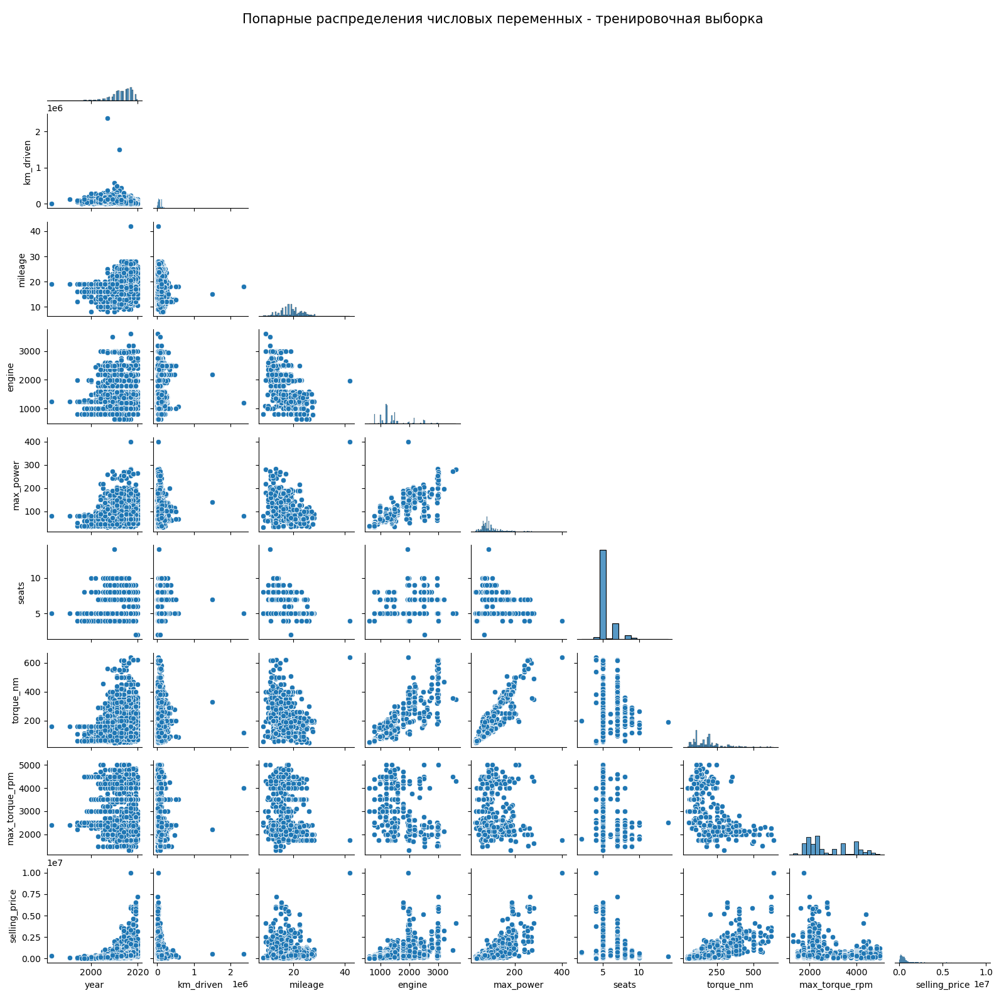

In [93]:
a = sns.pairplot(df_train, diag_kind='hist', corner=True, height=2.2)
a.fig.suptitle('Попарные распределения числовых переменных - тренировочная выборка', fontsize=15)
a.fig.set_size_inches(16, 16)
plt.show()

**Предполагаемая связь признаков и `selling_price`**
- `year` - видна положительная связь: чем новее машина, тем выше цена
- `km_driven` - отрицательная связь: чем больше пробег, тем цена ниже, из-за отдельных выбросов
- `mileage` -  нет особой связи или она слабая, нелинейная 
- `engine`, `max_power`, `torque_nm` -  положительная связь: чем больше объём двигателя, мощность, крутящий момент, тем цена выше
- `seats` - связь слабая, так как цена может быть разной и в рамках одного количства мест, вертикальные полосы говорят о дискретности признака
- `max_torque_rpm` - нет яркой зависимости, точки как будто могут быть распределены по 2 группам

**Возможная корреляция признаков**
- положительная:
    - `engine` и `max_power` - точки выстраиваются в возрастающую линию
    - `max_power` и `torque_nm`, `engine` и `torque_nm` - чем мощнее двигатель и больше объём двигателя, тем больше крутящий момент
- отрицательная:
    - все предыдущие 3 признака и `mileage` - связь не такая явная, но заметна на графике
    - `year` и `km_driven` - не очень ярко видно из-за выбросов, но более новые машины обычно с меньшим пробегом
    - `torque_nm` и `max_torque_rpm` - возможно связь нелинейная

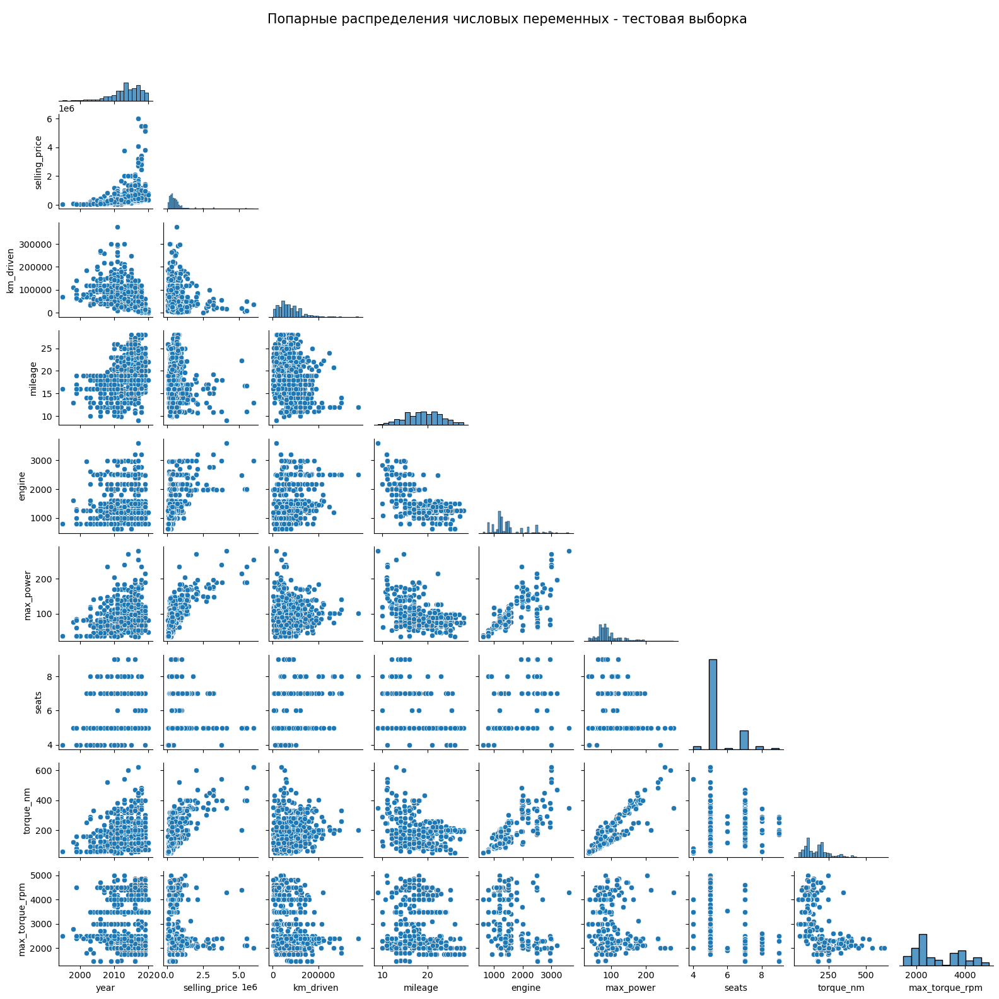

In [94]:
a = sns.pairplot(df_test, diag_kind='hist', corner=True, height=2.2)
a.fig.suptitle('Попарные распределения числовых переменных - тестовая выборка', fontsize=15)
a.fig.set_size_inches(16, 16)
plt.show()

**сравнение**

- совокупности похожи, заметны те же коррляции и связь
- в пробеге нет выбросов поэтому лучше видна отрицательная связь с годом и с ценой

### **Задание 9 (0.5 балла)**

Итак, вы выдвинули гипотезы о наличии связи. Теперь давайте оценим эту связь в числах.

**Задание:**
- [x] Получите значения коэффициента корреляции Пирсона для тренировочного набора данных при помощи `pd.corr()`
- [x] По полученным корреляциям постройте тепловую карту (`heatmap` из бибилотеки seaborn)

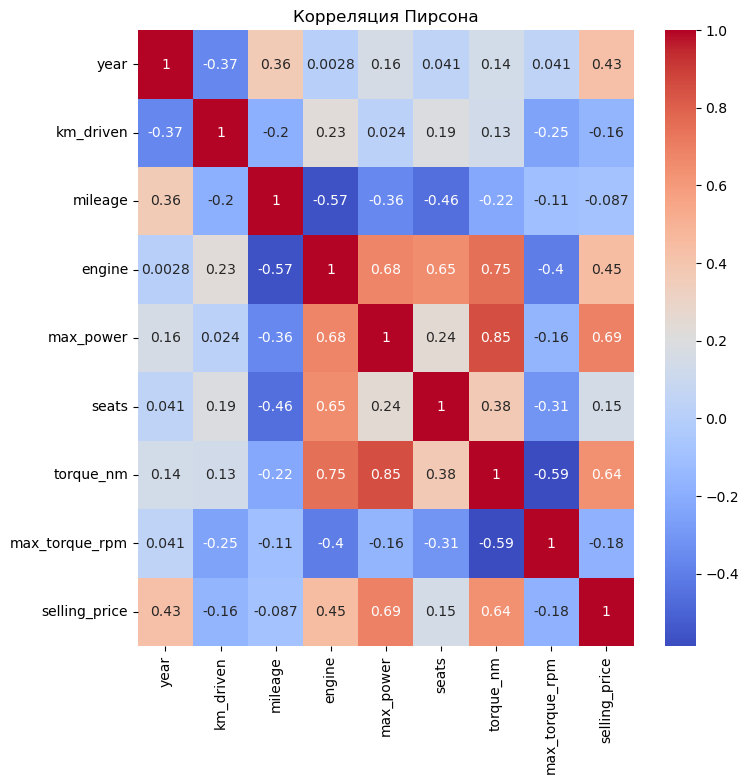

In [95]:
corr = df_train[num_col].corr()
plt.figure(figsize=(8, 8))
sns.heatmap(corr, cmap='coolwarm', annot=True)
plt.title('Корреляция Пирсона')
plt.show()

- [x] Ответьте на вопросы:
 - Какие 2 признака наименее скоррелированы между собой?
 - Между какими наблюдается довольно сильная положительная линейная зависимость?
 - Правильно ли, опираясь на данные, утверждать, что чем меньше год, тем, скорее всего, больше километров проехала машина к дате продажи?
 - Изучите типы корреляций в `pd.corr()`. Какую вы использовали по умолчанию?

`Your answer here`
- наимене скоррелированы объем двигателя и год машины - 0.0028
- сильная положительная линейная зависимость - крутящий момент и мощность двигателя, объем двигателя; цена и мощность двигателя, крутящий момент
- *Правильно ли, опираясь на данные, утверждать, что чем меньше год, тем, скорее всего, больше километров проехала машина к дате продажи?*  такая тенденция есть, но она несильно выражена
- по умолчанию используется коррляция Пирсона

### **Задание 10 (0.6 балла)**

По умолчанию `pd.corr` возвращает корреляцию Пирсона, говорящую о линейной взаимосвязи. Но зависимости существуют не только линейные! В этой задаче, попробуйте измерить другие способы вычисления корреляций.

- [x] Реализуйте корреляцию Спирмена/Кендала (на выбор) без использования библиотек (можно пользоваться только `numpy`). Сравните результаты вычисления с библиотечной реализацией
- [x] Сделайте выводы


Постройте матрицу корреляции [phik](https://pypi.org/project/phik/)
- [x] Проинтерпретируйте результаты


Поскольку в данном датасете в столбцах не все значения уникальные и есть множество повторяющихся, необходимо учесть этот факт при проставлении рангов, будем использовать усреднение рангов в ситуации когда несколько значений одинаковые:

Попробуем использовать формулу для корреляции Спирмена с пары, сначала отранжируем значения

In [96]:
def spearman_formula(x: np.ndarray, y: np.ndarray) -> float:
    x = np.asarray(x)
    y = np.asarray(y)
    n = x.size
    if n != y.size or n < 2:
        return np.nan
        
    rx = np.empty(n, dtype=float)
    ry = np.empty(n, dtype=float)

    rx[np.argsort(x)] = np.arange(1, n + 1)
    ry[np.argsort(y)] = np.arange(1, n + 1)

    d = rx - ry
    return float(1.0 - (6.0 * np.sum(d * d)) / (n * (n**2 - 1)))

In [97]:
num_col

['year',
 'km_driven',
 'mileage',
 'engine',
 'max_power',
 'seats',
 'torque_nm',
 'max_torque_rpm',
 'selling_price']

In [98]:
for j in range(8):
    for i in num_col[:-1-j]:
        x = df_train[i].to_numpy()
        y = df_train[num_col[-1-j]].to_numpy()
        sp = spearman_formula(x, y)
        print(round(sp, 2), end=' ')
    print()

0.71 -0.3 0.05 0.46 0.61 0.22 0.6 -0.26 
0.0 -0.31 -0.16 -0.47 -0.15 -0.21 -0.66 
0.12 0.24 -0.12 0.83 0.78 0.29 
0.05 0.11 -0.3 0.36 0.2 
0.17 0.04 -0.28 0.71 
-0.04 0.3 -0.41 
0.36 -0.2 
-0.57 


Сравнивать матрицы нужно зеркально: первая строка значений наверху - это последняя строка матрицы внизу

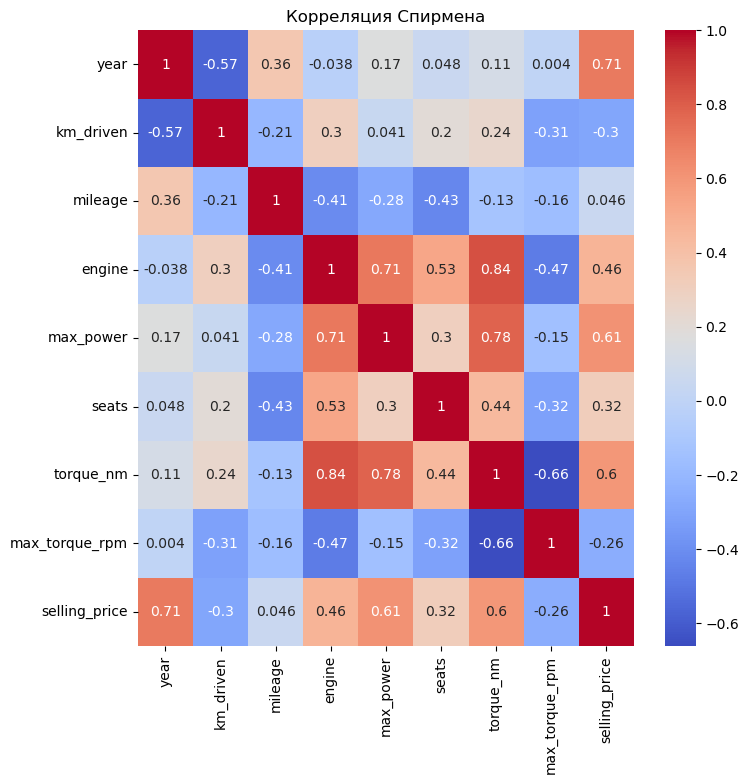

In [99]:
corr_s = df_train.corr(method='spearman', numeric_only=True)
plt.figure(figsize=(8, 8))
sns.heatmap(corr_s, cmap='coolwarm', annot=True)
plt.title('Корреляция Спирмена')
plt.show()

**Сравнение**
- малые отличия(одна сотая): цена-пробег, цена-крутящий момент, год - крутящий момент, сидения-пробег, сидения - мощность, год-объем двигателя, объем двигателя-пробег, расход топлива - год, расход топлива- пробег
- есть отличия (одна десятая и больше): цена-сидения, обороты - сидения, крутящий момент - сидения, сидения-расход топлива, сидения - объем двигателя
- в остальных парах совпадает как минимум до сотой

**Почему есть отличия**

- в столбцах есть одинаковые значения, так как все строки не являются уникальными, тогда при ранжировании одинаковым значениям дается такой ранг будто один больше другого, хотя они равны, это может добавить шум и изменить сумму квадратов разности между колонками. Более заметная разница в тех столбцах, где мало уникальных числовых значений, например, в корреляции со столбцом `seats`
- в методе из библиотеки учтен момент повторения значений в рамках одного столбца, одинаковым значениям дается один и тот же ранг - применяют усреднение ранга и расчитывают корреляцию Пирсона для рангов двух признаков

**Выводы**
- сохраняется сильная корреляция между `torque_nm`, `engine`, `max_power` - возможно показатели будут лучше при регуляризации
- заметна более сильная корреляция по Спирмену между ценой и годом, сидениями и пробег
- уменьшилась корреляция цены и крутящего момента и мощности, возможно, связь между ними ближе к линейной
- признак количества оборотов при корреляции Спирмена показывает более яркий результат, значит связь может быть нелинейной с ценой и крутящим моментом
- более сильной стала корреляция между годом и пробегом

Таким образом, Спирмен показывает более сильные связи там, где зависимость монотонная, но не линейная (год-пробег, цена-сидения, цена-пробег, цена-год)

C:\Users\79104\anaconda3\Lib\site-packages\phik\data_quality.py:59: UserWarning: The number of unique values of variable name is large: 1923. Are you sure this is not an interval variable? Analysis for pairs of variables including name can be slow.
  warnings.warn(


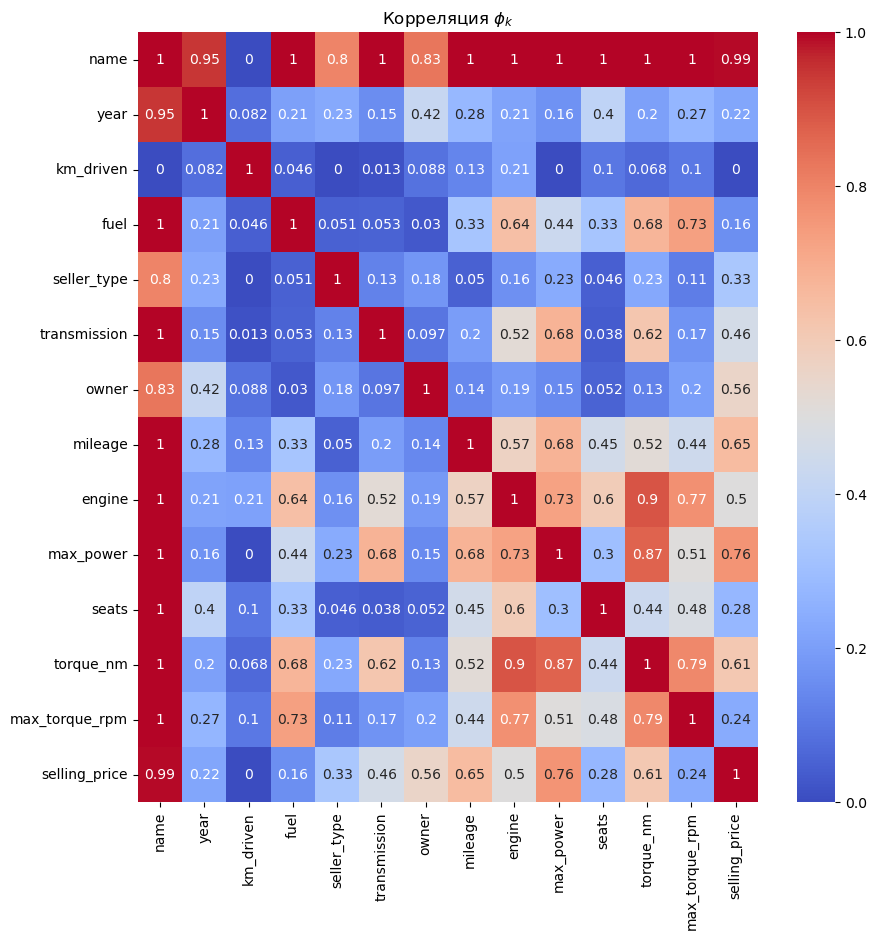

In [100]:
exclude = ['seats', 'name', 'transmission', 'owner', 'fuel', 'seller_type']
inter = df_train.columns.difference(exclude).tolist()
p_ma = df_train.phik_matrix(interval_cols=inter)

plt.figure(figsize=(10, 10))
sns.heatmap(p_ma, cmap='coolwarm', annot=True)
plt.title('Корреляция $\phi_k$')
plt.show()

**Выводы**
- `engine`, `max_power`, `torque_nm` — везде демонстрируют сильную связь с ценой, также есть сильная корреляция между этими признаками
- ярко выделен признак `name`, который коррелирует практически со всеми признаками идеально - модель, марка и комплектация определяют все остальные показатели машины, кроме пробега, а также продавца и владельца машины по счету, что логично, по сути данная переменная заключает в себе информацию по числовым показателям и характеристикам машины
    - в дальнейшем, скорее всего, будет необходимо разбить name на несколько столбцов 
- возможно есть нелинейная зависимость между расходом топлива и ценой

### **Дополнительные визуализации (бонус 0.25 балла)**

Если вам кажется, что мы не попросили вас нарисовать какие-то очень важные зависимости, нарисуйте их и поясните.
Один график: 0.125 балла, при условии, что он обоснован.

In [101]:
#основа на llm, но отредактировано
def plot_num_and_log(df: pd.DataFrame, col: str, *, bins: int = 40, figsize=(14, 4.5)):

    s = df[col]
    x = s.values
    x_log = np.log1p(x)
    x_log = pd.Series(x_log).replace([np.inf, -np.inf], np.nan).dropna().values

    fig = plt.figure(figsize=figsize)
    gs = GridSpec(nrows=2, ncols=2, height_ratios=[3, 1], wspace=0.25, hspace=0.05)

    #обычные графики
    ax_hist_1 = fig.add_subplot(gs[0, 0])
    ax_box_1  = fig.add_subplot(gs[1, 0], sharex=ax_hist_1)

    sns.histplot(x=x, bins=bins, kde=True, ax=ax_hist_1)
    ax_hist_1.set_title(f"Распределение признака {col}")
    ax_hist_1.set_xlabel("")
    ax_hist_1.grid(True, axis="y", alpha=0.3)

    sns.boxplot(x=x, orient="h", ax=ax_box_1)
    ax_box_1.set_xlabel(col)
    ax_box_1.set_yticks([])
    ax_box_1.grid(True, axis="x", alpha=0.3)

    # признак отлогарифмирован
    ax_hist_2 = fig.add_subplot(gs[0, 1])
    ax_box_2  = fig.add_subplot(gs[1, 1], sharex=ax_hist_2)

    sns.histplot(x=x_log, bins=bins, kde=True, ax=ax_hist_2)
    ax_hist_2.set_title(f'Логарифм признака {col}')
    ax_hist_2.set_xlabel("")
    ax_hist_2.grid(True, axis="y", alpha=0.3)

    sns.boxplot(x=x_log, orient="h", ax=ax_box_2)
    ax_box_2.set_xlabel(f"логарифм {col}")
    ax_box_2.set_yticks([])
    ax_box_2.grid(True, axis="x", alpha=0.3)

    plt.setp(ax_hist_1.get_xticklabels(), visible=False)
    plt.setp(ax_hist_2.get_xticklabels(), visible=False)

    plt.show()

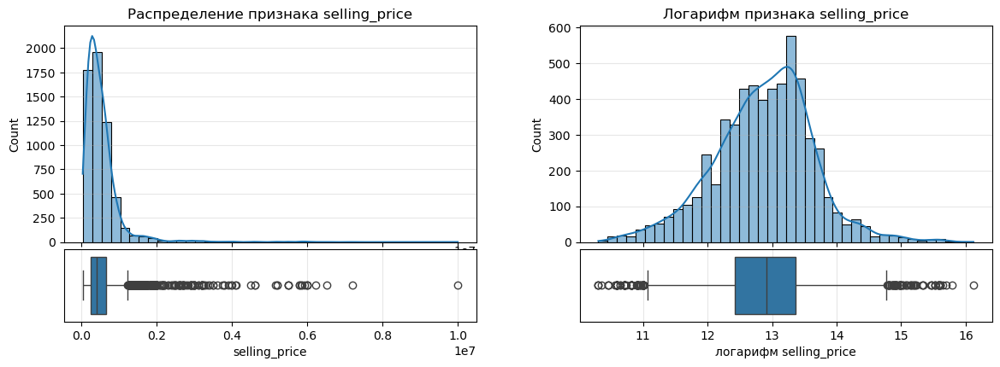

In [102]:
plot_num_and_log(df_train, 'selling_price')

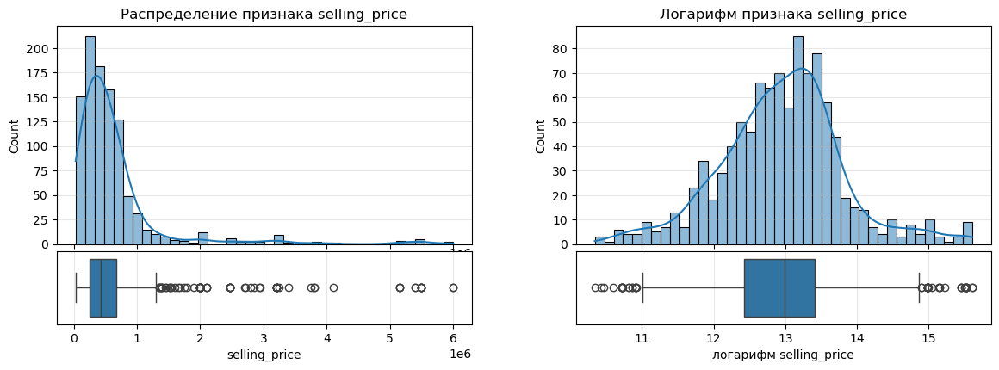

In [103]:
plot_num_and_log(df_test, 'selling_price')

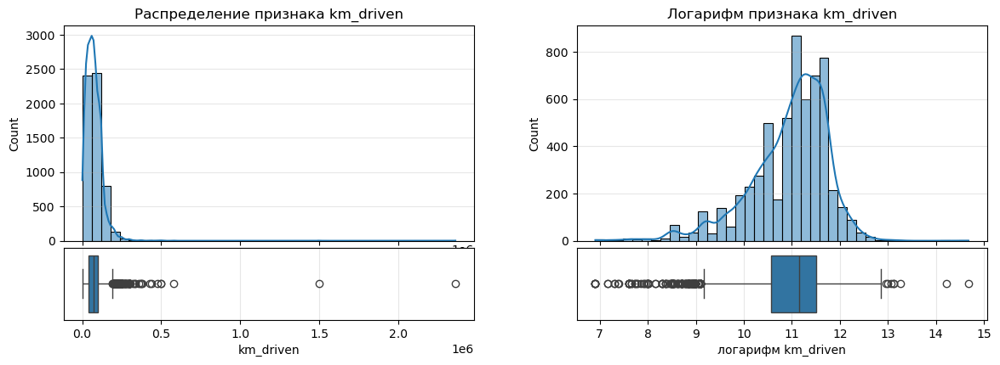

In [104]:
plot_num_and_log(df_train, 'km_driven')

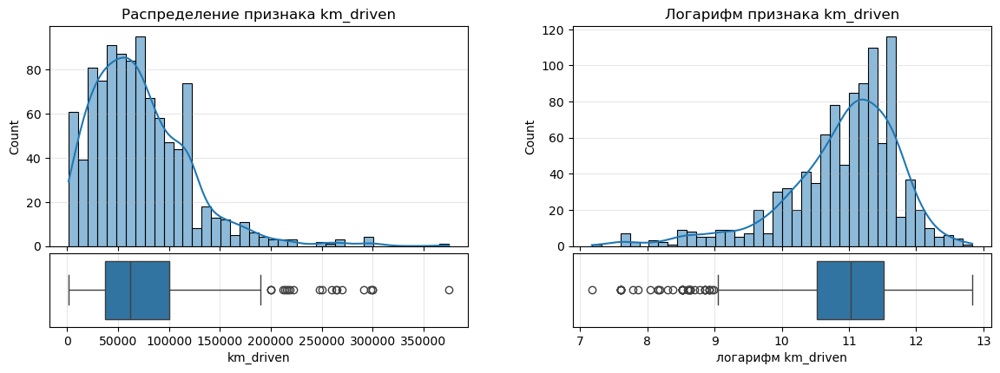

In [105]:
plot_num_and_log(df_test, 'km_driven')

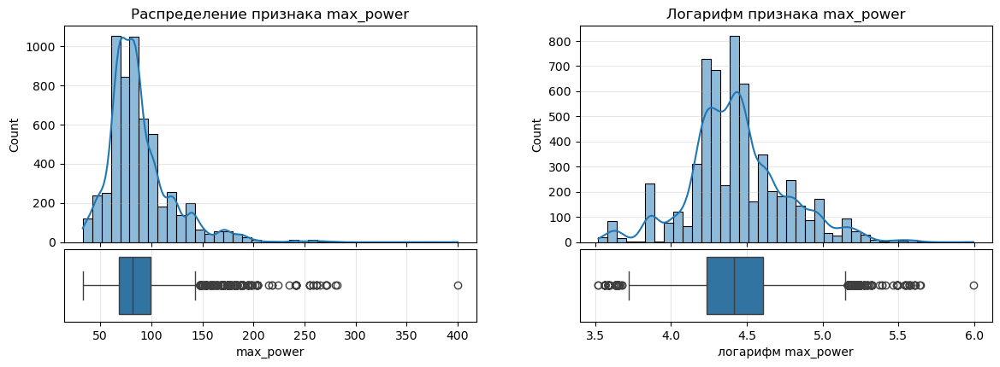

In [106]:
plot_num_and_log(df_train, 'max_power')

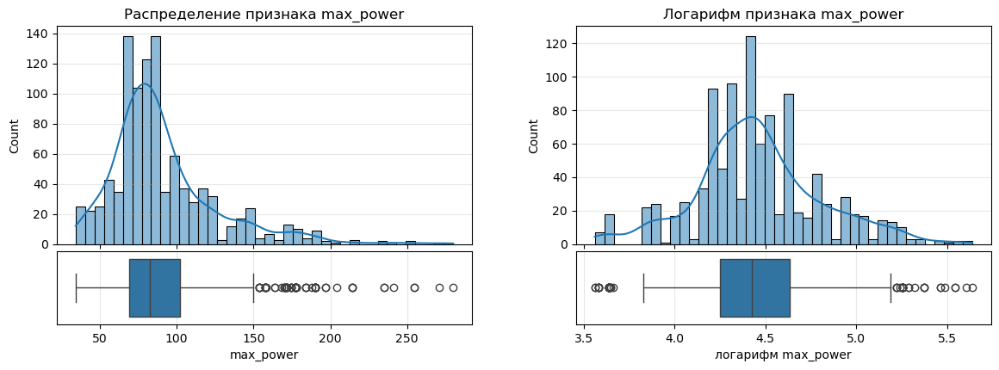

In [107]:
plot_num_and_log(df_test, 'max_power')

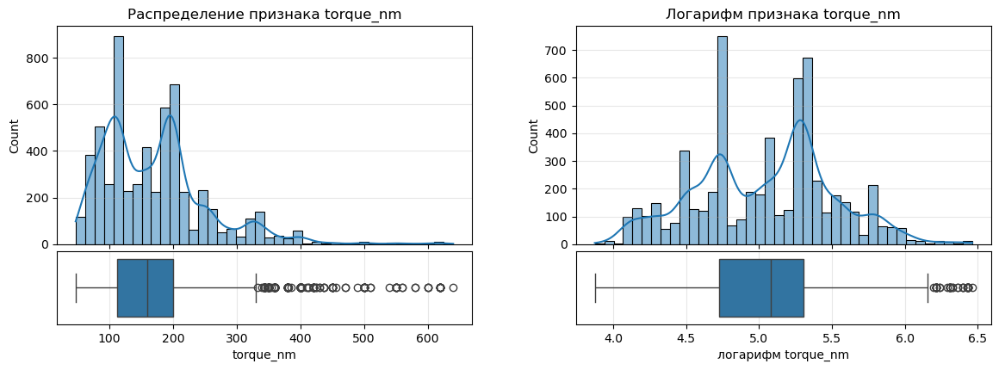

In [108]:
plot_num_and_log(df_train, 'torque_nm')

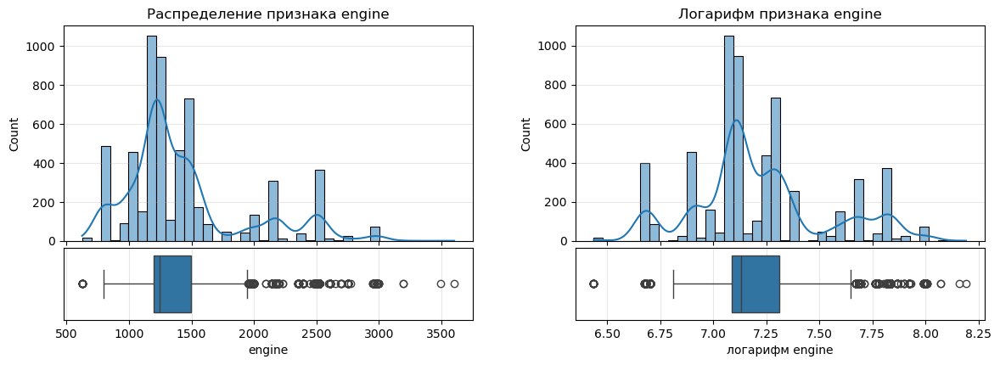

In [109]:
plot_num_and_log(df_train, 'engine')

**Выводы**
- планируем логарифмировать все признаки, кроме engine в части 4

In [110]:
#тут просто сделано при помощи llm
def plot_price_box_by_category(
    df: pd.DataFrame,
    cat_col: str,
    *,
    target: str = "selling_price",
    top_n: int | None = None,
    order_by: str = "median",   # "median" | "count" | None
    showfliers: bool = False,
    log_y: bool = False,
    figsize=(12, 5),
    rotate_xticks: int = 25,
    palette: str = "tab20",     # <-- добавили палитру
):
    """
    Boxplot target по категориальному признаку.

    top_n: оставить только top_n категорий (по частоте).
    order_by: сортировать категории по median(target) или count.
    log_y: лог-шкала по оси Y (полезно для цены с хвостом).
    palette: палитра seaborn для разноцветных боксплотов.
    """
    data = df[[cat_col, target]].copy()
    data = data.dropna()
    data[target] = pd.to_numeric(data[target], errors="coerce")
    data = data.dropna(subset=[target])

    if top_n is not None:
        top_vals = data[cat_col].value_counts().head(top_n).index
        data = data[data[cat_col].isin(top_vals)]

    if order_by == "median":
        order = data.groupby(cat_col)[target].median().sort_values().index
    elif order_by == "count":
        order = data[cat_col].value_counts().index
    elif order_by is None:
        order = None
    else:
        raise ValueError("order_by must be 'median', 'count' or None")

    n_cat = data[cat_col].nunique()
    colors = sns.color_palette(palette, n_colors=n_cat)

    fig, ax = plt.subplots(figsize=figsize)
    sns.boxplot(
        data=data,
        x=cat_col,
        y=target,
        order=order,
        palette=colors,      
        showfliers=showfliers,
        ax=ax
    )

    ax.set_title(f"{target} по категориям: {cat_col}")
    ax.set_xlabel(cat_col)
    ax.set_ylabel(target)

    if log_y:
        ax.set_yscale("log")

    if rotate_xticks and len(data[cat_col].unique()) > 5:
        ax.tick_params(axis="x", rotation=rotate_xticks)

    ax.grid(True, axis="y", alpha=0.3)
    plt.tight_layout()
    plt.show()

C:\Users\79104\AppData\Local\Temp\ipykernel_18804\4108912351.py:33: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  order = data.groupby(cat_col)[target].median().sort_values().index
C:\Users\79104\AppData\Local\Temp\ipykernel_18804\4108912351.py:45: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


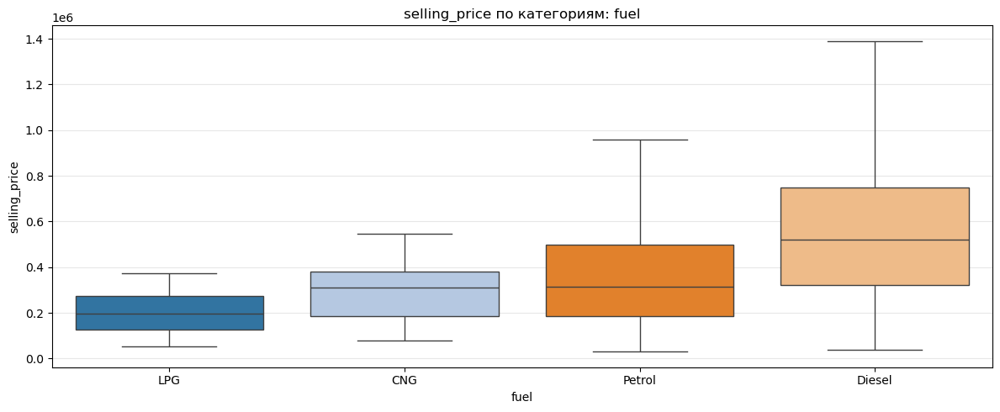

In [111]:
plot_price_box_by_category(df_train, 'fuel')

C:\Users\79104\AppData\Local\Temp\ipykernel_18804\4108912351.py:33: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  order = data.groupby(cat_col)[target].median().sort_values().index
C:\Users\79104\AppData\Local\Temp\ipykernel_18804\4108912351.py:45: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


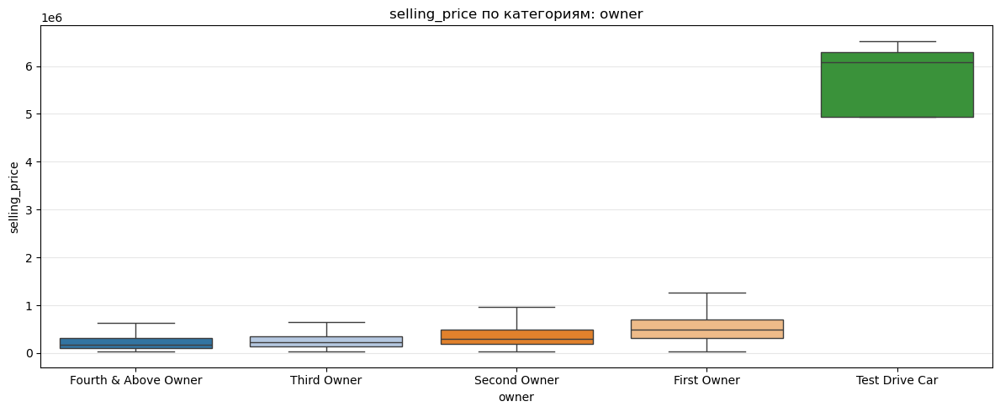

In [112]:
plot_price_box_by_category(df_train, 'owner')

C:\Users\79104\AppData\Local\Temp\ipykernel_18804\4108912351.py:33: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  order = data.groupby(cat_col)[target].median().sort_values().index
C:\Users\79104\AppData\Local\Temp\ipykernel_18804\4108912351.py:45: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


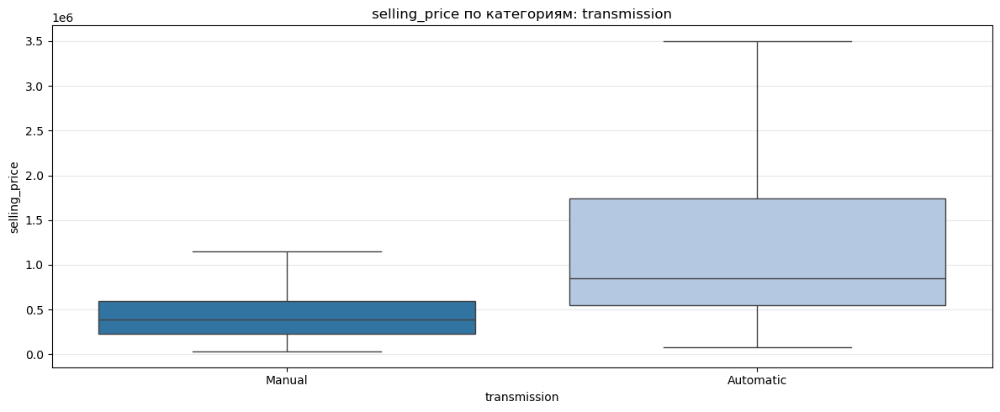

In [113]:
plot_price_box_by_category(df_train, 'transmission')

C:\Users\79104\AppData\Local\Temp\ipykernel_18804\4108912351.py:33: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  order = data.groupby(cat_col)[target].median().sort_values().index
C:\Users\79104\AppData\Local\Temp\ipykernel_18804\4108912351.py:45: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


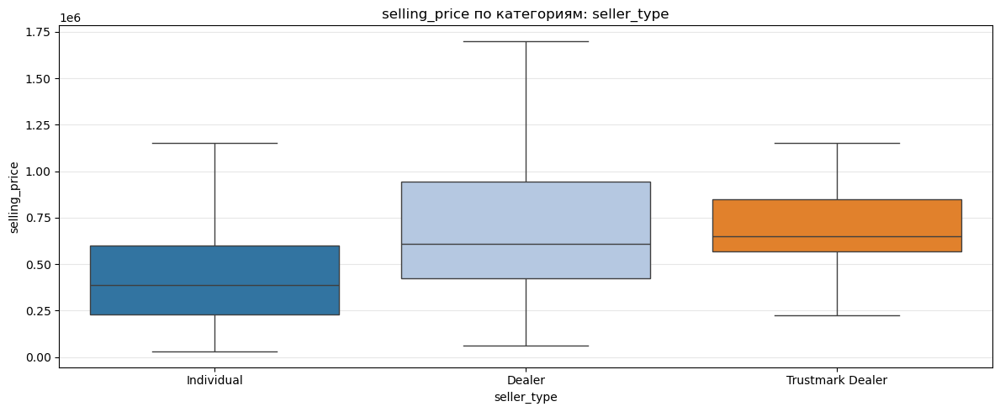

In [114]:
plot_price_box_by_category(df_train, 'seller_type')

- fuel (Diesel заметно дороже)
- transmission (Automatic дороже)
- seller_type (Dealer/Trustmark дороже Individual)
- owner (монотонный тренд + аномальный “Test Drive Car”, по хорошему можно кодировать ordinal)

C:\Users\79104\AppData\Local\Temp\ipykernel_18804\4108912351.py:33: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  order = data.groupby(cat_col)[target].median().sort_values().index
C:\Users\79104\AppData\Local\Temp\ipykernel_18804\4108912351.py:45: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


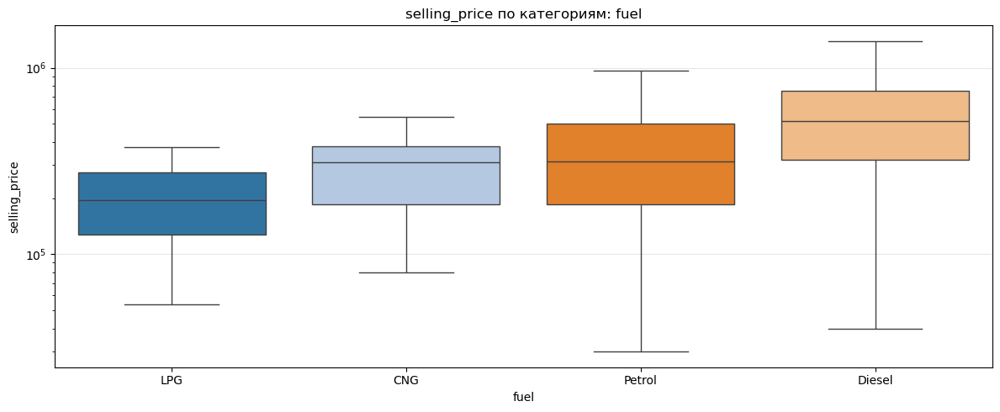

C:\Users\79104\AppData\Local\Temp\ipykernel_18804\4108912351.py:33: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  order = data.groupby(cat_col)[target].median().sort_values().index
C:\Users\79104\AppData\Local\Temp\ipykernel_18804\4108912351.py:45: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


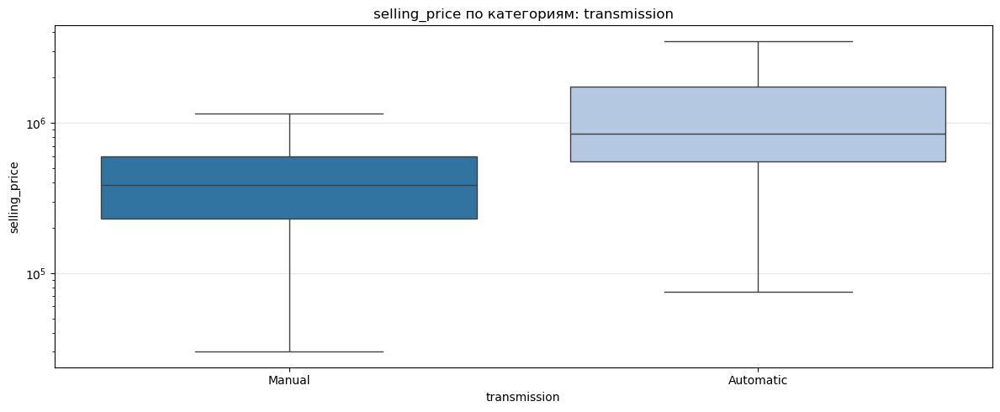

C:\Users\79104\AppData\Local\Temp\ipykernel_18804\4108912351.py:33: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  order = data.groupby(cat_col)[target].median().sort_values().index
C:\Users\79104\AppData\Local\Temp\ipykernel_18804\4108912351.py:45: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


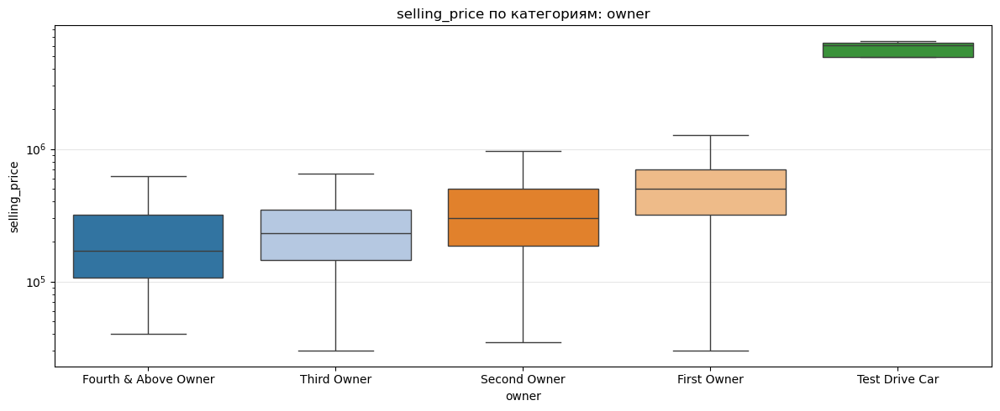

C:\Users\79104\AppData\Local\Temp\ipykernel_18804\4108912351.py:33: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  order = data.groupby(cat_col)[target].median().sort_values().index
C:\Users\79104\AppData\Local\Temp\ipykernel_18804\4108912351.py:45: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


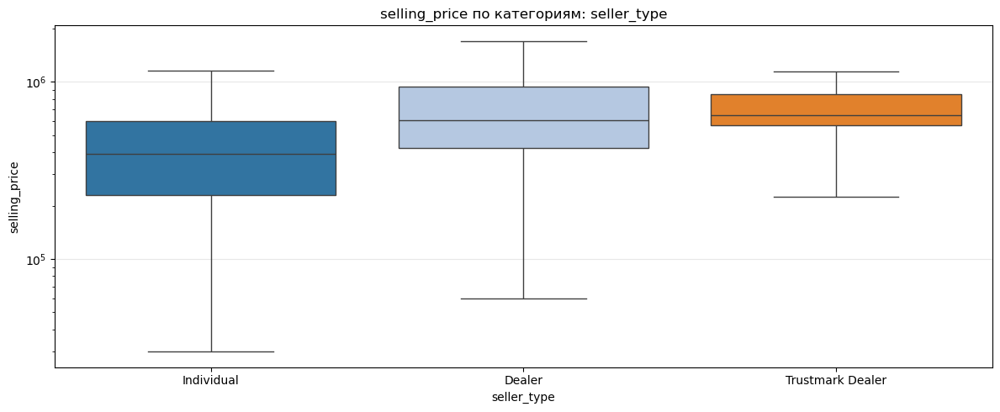

In [115]:
plot_price_box_by_category(df_train, 'fuel', log_y=True)
plot_price_box_by_category(df_train, 'transmission', log_y=True)
plot_price_box_by_category(df_train, 'owner', log_y=True)
plot_price_box_by_category(df_train, 'seller_type', log_y=True)

Цена может зависеть не столько отдельно от года и пробега, а от этих категорий вместе, то есть если машина старая, но у нее не так много пробега, то она может оказаться дороже 
разделим года и пробег на 10 бинов по квантилям

C:\Users\79104\AppData\Local\Temp\ipykernel_18804\2540780579.py:6: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pivot = df.pivot_table(index='km_bin', columns='year_bin', values='selling_price', aggfunc='median')


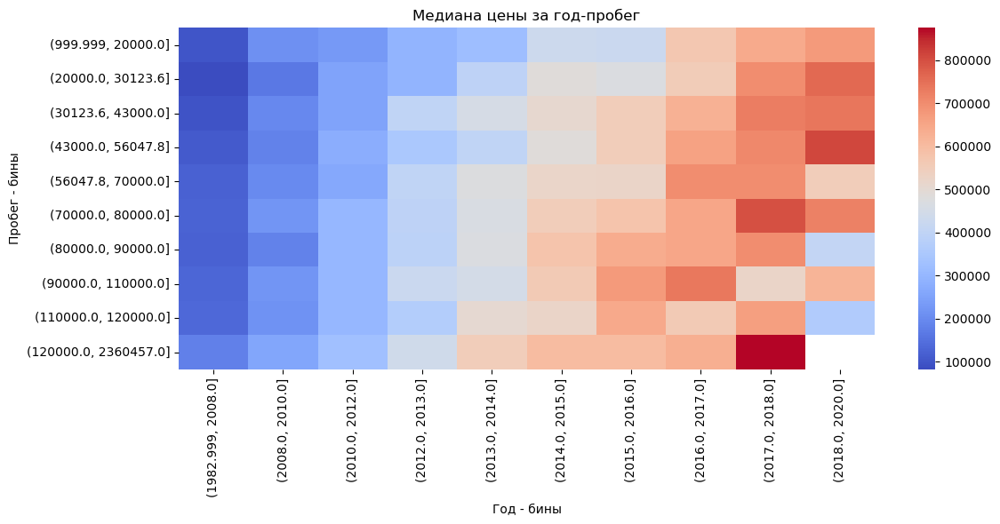

In [116]:
df = df_train.copy()

df['year_bin'] = pd.qcut(df['year'], q=10, duplicates='drop')
df['km_bin']   = pd.qcut(df['km_driven'], q=10, duplicates='drop')

pivot = df.pivot_table(index='km_bin', columns='year_bin', values='selling_price', aggfunc='median')

plt.figure(figsize=(12, 6))
sns.heatmap(pivot, cmap='coolwarm')
plt.title('Медиана цены за год-пробег')
plt.xlabel('Год - бины')
plt.ylabel('Пробег - бины')
plt.tight_layout()
plt.show()

**Вывод**
- медиана растет равномерно практически во всех строках, что подтверждает сильную зависимость от года
- при этом по столбцам, то есть где видна зависимость от года, не наблюдается такой сильной зависимости, например, машины до 2008 года дешевые вне зависимости от пробега, среди более новых машин дорогие автомобили встречаются в разных бинах пробега, связь нелинейная
- нужно учитывать, что были выбросы по пробегам, поэому вероятно, может быть мало значений в ярко красных ячейках

Возможные действия в дальнейшем:
- можно создать признак age на основе года машины
- можно прологаримировать признаки с хвостом (относится не только к этим, но и к другим с большими выбросами)
- добавить сочетание признаков age * пробег, пробег * год

# **Часть 2 (1.7 балла) | Модель только на вещественных признаках**

В этой части вам предстоит обучить модель только на вещественных признаках. Почему только на них?

Чем больше признаковое пространство — чем сложнее модель. А чем модель проще — тем лучше для скорости работы и интерпретации признаков.

За задания этой части вы можете набрать 1.7 основных и 0.15 бонусных балла;

### **Задание 11 (0.05 балла)**

Разбейте данные на тренировочный и тестовый наборы. Перед разбиением создайте копию датафрейма, который будет хранить только вещественные признаки и используйте его (то есть категориальные столбцы (все, кроме seats) необходимо удалить).

В переменные y_train и y_test запишите значения целевых переменных.

In [117]:
num_train = df_train[num_col]
num_test = df_test[num_col]

In [118]:
y_train = num_train['selling_price']
X_train = num_train.drop('selling_price', axis=1)
X_train.shape

(5839, 8)

In [119]:
#assert X_train.shape == (5840, 6)

In [120]:
y_test = num_test['selling_price']
X_test = num_test.drop('selling_price', axis=1)
X_test.shape

(1000, 8)

In [121]:
#assert X_test.shape == (1000, 6)

### **Задание 12. (0.2 балла)**

Построим нашу первую модель!
- [x] Обучите классическую линейную регрессию с дефолтными параметрами. Посчтитайте $R^2$ и $MSE$ для трейна и для теста.
- [x] Сделайте выводы по значениям метрик качества.

**Примечание:**

Здесь и далее $R^2$ и $MSE$ для трейна и для теста выводите везде, где требуется обучать модели, даже если в явном виде этого не просят. Иначе непонятно, как понять, насколько успешны наши эксперименты.

In [122]:
def met(y_train, y_pred_train, y_test, y_pred_test):
    mse_tr = MSE(y_train, y_pred_train)
    mse_te = MSE(y_test, y_pred_test)
    r2_tr = r2_score(y_train, y_pred_train)
    r2_te = r2_score(y_test, y_pred_test)
    print('For train:')
    print('MSE:', round(mse_tr, 2))
    print('RMSE:', round(mse_tr**0.5, 2))
    print('r2:', round(r2_tr, 3))
    print()
    print('For test:')
    print('MSE:', round(mse_te, 2))
    print('RMSE:', round(mse_te**0.5, 2))
    print('r2:', round(r2_te, 3))

In [123]:
lr = LinearRegression()
lr.fit(X_train, y_train)
y_pred_tr_lr = lr.predict(X_train)
y_pred_te_lr = lr.predict(X_test)

met(y_train, y_pred_tr_lr, y_test, y_pred_te_lr)

For train:
MSE: 113543624460.46
RMSE: 336962.35
r2: 0.604

For test:
MSE: 229934260248.52
RMSE: 479514.61
r2: 0.6


**Выводы**
- судя по метрикам, есть куда улучшать модель, зато нет переобучения
- линейная регрессия объясняет только около 60% дисперсии (вариации цены)
- ошибка rmse на тестовых данных заметно больше, хотя r2 почти одинаково
- большие значения rmse могут быть из-за длинного хвоста цены, так как есть очень дорогие машины, а метрика чувствительна к выбросам

### **Задание 13 (0.15 балла)**

- [x] Реализуйте $R^2$ руками. Приведите формулу $R^2$ и объясните каждую компоненту метрики

In [124]:
def r2_m(y_true, y_pred):
    y_true = np.asarray(y_true, dtype=float)
    y_pred = np.asarray(y_pred, dtype=float)

    y_mean = y_true.mean()
    verh = np.sum((y_pred - y_true)**2)     
    niz = np.sum((y_true - y_mean)**2)

    return 1 - verh / niz

`Your answer here`

Значение коэффициента детерминации считается как MSE разделить на дисперсию целевой переменной выборки
- verh: сумма квадратов ошибок - то есть из предсказанного значения вычитаем правильное и возводим ошибку в квадрат
- niz: константное значение для выборки: из истинного значения вычитаем среднее значение целевой переменной
- из единицы делим частное и определяем качество: если ошибок нет, то 1-0 = 1, идеальное качество, если равно r2=0, значит все предсказания, то есть модель предсказывает примерно так же, как если бы предсказывала среднее значение, если отрицательное значение, то хуже

### **Бонус (0.15 балла)**

- [x] Реализуйте [$\text{adjusted}-R^2$](https://en.wikipedia.org/wiki/Coefficient_of_determination).
- [x] Объясните, когда применяется $\text{adjusted}-R^2$?

In [125]:
def adj_r2(y_true, y_pred, x):
    y_true = np.asarray(y_true, dtype=float)
    y_pred = np.asarray(y_pred, dtype=float)
    n = y_true.size

    r2 = r2_m(y_true, y_pred)
    return 1.0 - (1.0 - r2) * (n - 1) / (n - x - 1)

`Your answer here` 
- **применяется:** для сравнения моделей с разным количеством признаков
    - при отборе признаков
    - сравнение моделей разной сложности с разным количеством признаков (5 и 20 признаков, например) 
- помогает понять, стало ли качество модели действительно лучше, так как метрика r2 не отразит этого
- если добавить новые признаки, то r2 или останется таким же, или вырастет, даже если признак не оказался полезным и не улучшил эффективность модели, то есть признаки могут не коррелировать с ценой, дублировать уже имеющиеся данные существующего признака
- если был подобран полезный признак, то ошибка снизится заметно, тогда r2adj вырастет, если нет, то останется прежним или уменьшится

Таким образом, r2 для ответа на вопрос, как хорошо моделью оценивается дисперсия целевой переменной, r2adj, чтобы оценить, как хорошо моделью объясняется дисперсия с учетом количества признаков, которые использовали

### **Задание 14 (0.05 балла)**

Всегда есть место совершенству. Поэтому давайте попробуем улучшить модель. При помощи стандартизации признаков.

- [x] Стандартизируйте значения в тренировочных и тестовых данных. Стандартизатор **обучайте только на `train`**.

In [126]:
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

X_train = pd.DataFrame(X_train, columns=num_col[:-1])
X_test = pd.DataFrame(X_test, columns=num_col[:-1])

In [127]:
lr_2 = LinearRegression()
lr_2.fit(X_train, y_train)
y_pred_tr_lr2 = lr_2.predict(X_train)
y_pred_te_lr2 = lr_2.predict(X_test)

met(y_train, y_pred_tr_lr2, y_test, y_pred_te_lr2)

For train:
MSE: 113543624460.46
RMSE: 336962.35
r2: 0.604

For test:
MSE: 229934260248.52
RMSE: 479514.61
r2: 0.6


In [128]:
print(np.mean(X_train, axis=0)[:5])
print(np.std(X_train, axis=0)[:5])

year        -9.604922e-15
km_driven   -7.666414e-17
mileage      4.076585e-16
engine       6.206145e-17
max_power   -1.472438e-16
dtype: float64
year         1.0
km_driven    1.0
mileage      1.0
engine       1.0
max_power    1.0
dtype: float64


**Вывод**
- после стандартизации нет никаких изменений

### **Задание 15 (0.1 балла)**

Хотя стандартизация не помогла сильно прибавить в качестве она открыла возможность интерпретировать важность признаков в модели. Правило интерпретации такое:

Чем больше коэффициент $\beta_i$ по модулю, тем важнее признак.

**Ответьте на вопрос:**

- [x] Какой признак оказался наиболее информативным в предсказании цены?

In [129]:
def imp(model):
    imp = pd.DataFrame({
        'feature': X_train.columns,
        'coef': model.coef_,
        'abs_coef': np.abs(model.coef_)
    }).sort_values('abs_coef', ascending=False).reset_index(drop=True)
    return imp

In [130]:
imp(lr_2)

,feature,coef,abs_coef
0,max_power,305795.446816,305795.446816
1,year,168141.405189,168141.405189
2,max_torque_rpm,-58403.724815,58403.724815
3,km_driven,-50998.402954,50998.402954
4,seats,-35162.227347,35162.227347
5,torque_nm,33939.803585,33939.803585
6,mileage,-19954.142355,19954.142355
7,engine,5064.790811,5064.790811


**Ответ**
- наибольшее влияние на формирование цены оказывает мощность двигателя, затем влияет новизна машины и число оборотов (то есть машины, у которых пик момента на низких оборотах будут стоить дороже)
- коэффициенты получились довольно большие, но это объясняется и большой ценой автомобиля
- вклад мощности практически в 2 раза весомее, чем года, а вклад года примерно в 3 раза больше, чем вклад следующего за ним признака

### **Задание 16 (0.25 балла)**

Попробуем улучшить нашу модель с помощью применения регуляризации. Для этого воспльзуемся `Lasso` регрессией.  Кроме того, попробуйте использовать её теоретическое свойство отбора признаков, за счет зануления незначимых коэффициентов.

**Задание:**

- [x] Обучите Lasso регрессию на тренировочном наборе данных с нормализованными признаками. Оцените её качество
- [x] Проверьте, занулила ли L1-регуляризация с параметрами по умолчанию какие-нибудь веса? Предположите почему.

In [131]:
lasso = Lasso()
lasso.fit(X_train, y_train)
y_pred_tr_la = lasso.predict(X_train)
y_pred_te_la = lasso.predict(X_test)

met(y_train, y_pred_tr_la, y_test, y_pred_te_la)

For train:
MSE: 113543624475.94
RMSE: 336962.35
r2: 0.604

For test:
MSE: 229935010351.36
RMSE: 479515.39
r2: 0.6


In [132]:
imp(lasso)

,feature,coef,abs_coef
0,max_power,305795.789430,305795.789430
1,year,168138.767673,168138.767673
2,max_torque_rpm,-58400.383206,58400.383206
3,km_driven,-50997.393884,50997.393884
4,seats,-35157.847581,35157.847581
5,torque_nm,33941.324094,33941.324094
6,mileage,-19950.209951,19950.209951
7,engine,5062.891061,5062.891061


**Выводы**
- значения практически не изменились, только на десятые доли, что несущественно, когда цены выражаются шестизначными числами
- регуляризация получается слишком слабая, поэтому метрики остались практически теми же, изменим показатель alpha
- если при увеличении alpha показатели не уменьшатся, то вероятно, все признаки полезные

### **Задание 17. Финальный рывок (0.4 балла)**

До этого мы с вами использовали `train` для обучения и `test` для прогнозирования. Но у нас есть ещё одна задача — подобрать оптимальные параметры модели. Для этого используем кросс-валидацию, описанную на семинарах.

Кроме того, выжмем максимум из модификаций регрессии. Построим `ElasticNet`. И сделаем всё по порядку.

**Ваша задача 1:**

- [x] Перебором по сетке (c 10-ю фолдами) подберите оптимальные параметры для Lasso-регрессии. Вам пригодится класс [GridSearchCV](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html).
- [x] Ответьте на вопросы:
 - Сколько грид-сёрчу пришлось обучать моделей?
 - Что значит каждый параметр `param_grid`, который вы заполняли для `GridSearch`? Опишите каждый
 - Какой коэффициент регуляризации у лучшей из перебранных моделей? Занулились ли какие-нибудь из весов при такой регуляризации?

In [133]:
param_grid = {'alpha': [0.01, 0.1, 1, 10, 100, 1000, 20000, 27000, 27900, 28000, 28100, 29000, 30000, 40000]}

gs = GridSearchCV(
    Lasso(),
    param_grid,
    n_jobs=-1,
    cv=10,
    scoring='r2'
)
gs.fit(X_train, y_train)

GridSearchCV(cv=10, estimator=Lasso(), n_jobs=-1,
             param_grid={'alpha': [0.01, 0.1, 1, 10, 100, 1000, 20000, 27000,
                                   27900, 28000, 28100, 29000, 30000, 40000]},
             scoring='r2')

In [134]:
gs.best_score_, gs.best_estimator_, gs.best_params_

(np.float64(0.585514112290181), Lasso(alpha=27900), {'alpha': 27900})

In [135]:
y_pred_tr_la2 = gs.predict(X_train)
y_pred_te_la2 = gs.predict(X_test)

met(y_train, y_pred_tr_la2, y_test, y_pred_te_la2)

For train:
MSE: 116815143683.65
RMSE: 341782.3
r2: 0.593

For test:
MSE: 250393317172.34
RMSE: 500393.16
r2: 0.564


In [136]:
imp(gs.best_estimator_)

,feature,coef,abs_coef
0,max_power,253727.910118,253727.910118
1,year,140157.626517,140157.626517
2,torque_nm,80203.791952,80203.791952
3,km_driven,-25531.900105,25531.900105
4,engine,0.000000,0.000000
5,mileage,0.000000,0.000000
6,seats,-0.000000,0.000000
7,max_torque_rpm,-0.000000,0.000000


*Сколько грид-сёрчу пришлось обучать моделей?*
- 10 фолдов и 14 вариантов alpha, значит 140 моделей

*Что значит каждый параметр param_grid, который вы заполняли для GridSearch? Опишите каждый*
- для данной задачи подбирался только alpha - коэффициент регуляризации, то, насколько сильно модель будут штрафовать за большие веса, большое значение = большой штраф
- больше значений param_grid для данной модели мы не подбираем

*Какой коэффициент регуляризации у лучшей из перебранных моделей? Занулились ли какие-нибудь из весов при такой регуляризации?*
- Лучший коэффициент регуляризации - 27900
- 4 признака стали 0
- при этом качество стало ниже на трейне и на тесте, чем было без применения резуляризации
- вероятнее всего признаков мало и нет необходимости их занулять

**Ваша задача 2:**

- [x] Перебором по сетке (c 10-ю фолдами) подберите оптимальные параметры для [ElasticNet](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.ElasticNet.html) регрессии.
- [x] Ответьте на вопрос:
 - Сколько грид-сёрчу пришлось обучать моделей?
 - Какие гиперпараметры соответствуют лучшей (по выбранной метрике качества) из перебранных моделей?

In [137]:
param_grid = {'alpha': [0.001, 0.01, 0.1, 0.5, 1, 10, 100, 1000, 5000, 10000, 20000, 30000, 40000, 50000, 100000],
               'l1_ratio': [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]
             }

gs2 = GridSearchCV(
    ElasticNet(),
    param_grid,
    n_jobs=-1,
    cv=10,
    scoring='r2'
)
gs2.fit(X_train, y_train)

GridSearchCV(cv=10, estimator=ElasticNet(), n_jobs=-1,
             param_grid={'alpha': [0.001, 0.01, 0.1, 0.5, 1, 10, 100, 1000,
                                   5000, 10000, 20000, 30000, 40000, 50000,
                                   100000],
                         'l1_ratio': [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8,
                                      0.9]},
             scoring='r2')

In [138]:
gs2.best_score_, gs2.best_estimator_, gs2.best_params_

(np.float64(0.5840372630554446),
 ElasticNet(alpha=1, l1_ratio=0.8),
 {'alpha': 1, 'l1_ratio': 0.8})

*Сколько грид-сёрчу пришлось обучать моделей?*

10 из l1_ratio * 15 из alpha * 10 фолдов = 1500

*Какие гиперпараметры соответствуют лучшей (по выбранной метрике качества) из перебранных моделей?*
- alpha = 1
- l1_ratio = 0.8

In [139]:
y_pred_tr_el = gs2.predict(X_train)
y_pred_te_el = gs2.predict(X_test)

met(y_train, y_pred_tr_el, y_test, y_pred_te_el)

For train:
MSE: 116546594064.02
RMSE: 341389.21
r2: 0.593

For test:
MSE: 250937534513.39
RMSE: 500936.66
r2: 0.563


In [140]:
imp(gs2.best_estimator_)

,feature,coef,abs_coef
0,max_power,188556.109592,188556.109592
1,year,137970.403170,137970.403170
2,torque_nm,120403.019145,120403.019145
3,km_driven,-53229.804146,53229.804146
4,engine,39019.962604,39019.962604
5,seats,-30807.323369,30807.323369
6,max_torque_rpm,-7759.722406,7759.722406
7,mileage,-4782.751881,4782.751881


Метрики в целом не стали лучше в сравнении с обычной линейной регрессией без регуляризации, значения коэффициентов уменьшились 

### **Задание 18 (0.35 балла)**

И так, вы обучили все варианты регуляризаций, доступные в sklearn, но не все, что мы обсудили на занятии! И следующее задание о забытой - $L0$ регуляризации.


**Ваша задача:**
- [x] Реализуйте модель с $L0$-регуляризаицей.
- [x] Обучите модель на данных и проанализируйте результат, экспериментируя с коэффициенитом регуляризации
- [x] Проанализируйте результаты обучения

**Важно:**

Вопреки тому, что L0 не реализована в стандартных пакетах, концепция данной регуляризации не является мертвой. Она может встречаться в [статьях](https://arxiv.org/abs/1712.01312) и экспериментах.



In [141]:
#сделано при помощи llm
def l0_grid_search(X_train, y_train, X_test, y_test, lambdas):
    cols = list(X_train.columns)
    p = len(cols)
    results = []

    for lam in lambdas:
        best = {"obj": np.inf}

        # выбираем лучшее подмножество ПРИ ФИКСИРОВАННОМ lambda по TRAIN objective
        for k in range(1, p + 1):
            for subset in combinations(cols, k):
                model = LinearRegression()
                model.fit(X_train[list(subset)], y_train)

                pred_tr = model.predict(X_train[list(subset)])
                mse_tr = MSE(y_train, pred_tr)

                obj = mse_tr + lam * k  # train objective (L0)

                if obj < best["obj"]:
                    best = {
                        "obj": obj,
                        "subset": subset,
                        "model": model,
                        "k": k,
                        "mse_tr": mse_tr,
                        "pred_tr": pred_tr
                    }

        # train metrics для лучшего subset при данном lambda
        r2_tr = r2_score(y_train, best["pred_tr"])

        # test metrics (считаем, но НЕ используем для выбора "лучшего lambda")
        pred_te = best["model"].predict(X_test[list(best["subset"])])
        mse_te = MSE(y_test, pred_te)
        r2_te = r2_score(y_test, pred_te)

        results.append({
            "lambda": lam,
            "k_selected": best["k"],
            "features": best["subset"],
            "train_mse": float(best["mse_tr"]),
            "train_rmse": float(np.sqrt(best["mse_tr"])),
            "train_r2": float(r2_tr),
            "test_mse": float(mse_te),
            "test_rmse": float(np.sqrt(mse_te)),
            "test_r2": float(r2_te),
            "objective_train": float(best["obj"]),
        })

    res = pd.DataFrame(results)

    # ===== ВЫБОР ЛУЧШЕЙ МОДЕЛИ ПО TRAIN =====
    # 1) по минимальному objective_train
    best_by_obj = res.loc[res["objective_train"].idxmin()].copy()

    # 2) по минимальному train_rmse
    best_by_rmse = res.loc[res["train_rmse"].idxmin()].copy()

    # 3) по максимальному train_r2
    best_by_r2 = res.loc[res["train_r2"].idxmax()].copy()

    # "гиперпараметры" L0-модели = lambda + k + выбранные признаки
    best_hyperparams = {
        "lambda": float(best_by_obj["lambda"]),
        "k_selected": int(best_by_obj["k_selected"]),
        "features": best_by_obj["features"]
    }

    res_sorted = res.sort_values(["objective_train", "k_selected"]).reset_index(drop=True)
    return res_sorted, best_by_obj, best_hyperparams

lambdas = np.logspace(7, 11, 15)
res_sorted, best_by_obj, best_hyperparams = l0_grid_search(X_train, y_train, X_test, y_test, lambdas)
res_sorted

,lambda,k_selected,features,train_mse,train_rmse,train_r2,test_mse,test_rmse,test_r2,objective_train
0,1.000000e+07,7,"(year, km_driven, mileage, max_power, seats, t...",1.135488e+11,336969.995499,0.603905,2.300103e+11,479593.874184,0.599863,1.136188e+11
1,1.930698e+07,7,"(year, km_driven, mileage, max_power, seats, t...",1.135488e+11,336969.995499,0.603905,2.300103e+11,479593.874184,0.599863,1.136839e+11
2,3.727594e+07,7,"(year, km_driven, mileage, max_power, seats, t...",1.135488e+11,336969.995499,0.603905,2.300103e+11,479593.874184,0.599863,1.138097e+11
3,7.196857e+07,7,"(year, km_driven, mileage, max_power, seats, t...",1.135488e+11,336969.995499,0.603905,2.300103e+11,479593.874184,0.599863,1.140526e+11
4,1.389495e+08,6,"(year, km_driven, mileage, max_power, seats, m...",1.136266e+11,337085.387036,0.603634,2.296791e+11,479248.438388,0.600439,1.144603e+11
5,2.682696e+08,5,"(year, km_driven, max_power, seats, max_torque...",1.138084e+11,337355.076457,0.602999,2.302805e+11,479875.510074,0.599393,1.151498e+11
6,5.179475e+08,4,"(year, km_driven, max_power, max_torque_rpm)",1.141873e+11,337916.067068,0.601678,2.327922e+11,482485.426372,0.595023,1.162591e+11
7,1.000000e+09,4,"(year, km_driven, max_power, max_torque_rpm)",1.141873e+11,337916.067068,0.601678,2.327922e+11,482485.426372,0.595023,1.181873e+11
8,1.930698e+09,4,"(year, km_driven, max_power, max_torque_rpm)",1.141873e+11,337916.067068,0.601678,2.327922e+11,482485.426372,0.595023,1.219101e+11
9,3.727594e+09,2,"(year, max_power)",1.189358e+11,344870.697531,0.585113,2.403446e+11,490249.566343,0.581885,1.263910e+11


In [142]:
feat = list(best_hyperparams['features'])
l0 = LinearRegression()
l0.fit(X_train[feat], y_train)

y_pred_tr_l0 = l0.predict(X_train[feat])
y_pred_te_l0 = l0.predict(X_test[feat])
met(y_train, y_pred_tr_l0, y_test, y_pred_te_l0)

For train:
MSE: 113548777866.91
RMSE: 336970.0
r2: 0.604

For test:
MSE: 230010284154.79
RMSE: 479593.87
r2: 0.6


**Итог**

Метрики все равно остались на уровне линейной регрессии без регуляризации, даже уступают на некоторую долю, при небольших лямбда регуляризации не было, так как малые значения никак не штрафовали модель 

При большом сокращении признаков качество также уменьшается вместе с метриками, если то же самое качество достижимо с меньшими признаками, то лучше та модель, в которой меньше признаков

# **Часть 3 (0.5 балла) | Добавляем категориальные фичи**

Попробуем для улучшения модели дать ей больше признаков. Добавим категориальные фичи.

За эту часть можно набрать 0.5 основных балла.



### **Задание 19 (0.1 балла)**

Проанализируйте столбец `name`. Очевидно, что эта переменная является категориальной, однако категорий в ней много.

- [x] Предобработайте столбец `name`, чтобы избежать его удаления

Предобработаем target enconding

In [143]:
X_train['name'] = df_train['name']
X_test['name'] = df_test['name']

In [144]:
X_train['name'].nunique()

1923

In [145]:
cnt = df_train['name'].value_counts()
(cnt == 1).mean(), (cnt <= 3).mean()

(np.float64(0.4737389495579823), np.float64(0.7940717628705148))

In [146]:
train_names = set(df_train['name'].unique())
test_names = df_test['name']

mask_unseen = ~test_names.astype(str).isin(train_names)
unseen_share = mask_unseen.mean() * 100

print(f'Доля строк test с unseen name: {round(unseen_share, 2)}%')
print(f'Уникальных name только в test: {len(set(test_names[mask_unseen].unique()))}')


Доля строк test с unseen name: 13.3%
Уникальных name только в test: 121


категорий, которые встречаются 1 раз 47%, а те, что встречаются до 3 раз включительно 79%, значит много редких категорий, то есть нужно сильное сглаживание

In [147]:
oof = pd.DataFrame(index=X_train.index)
oof['name_te'] = np.nan

kf = KFold(n_splits=5, shuffle=True, random_state=RANDOM_STATE)
for tr_idx, val_idx in kf.split(X_train):
    X_tr = X_train.iloc[tr_idx][['name']]
    X_val = X_train.iloc[val_idx][['name']]
    y_tr = y_train.iloc[tr_idx]
    
    te = TargetEncoder(cols=['name'], min_samples_leaf=200, smoothing=50)
    y_te = np.log1p(y_tr)
    
    te.fit(X_tr, y_te)
    X_val_te = te.transform(X_val)
    
    oof.loc[val_idx, 'name_te'] = X_val_te['name'].values

te_all = TargetEncoder(cols=['name'], min_samples_leaf=200, smoothing=50)
te_all.fit(X_train[['name']], np.log1p(y_train))
X_test_te = te_all.transform(X_test[['name']])['name'].values

X_train_enc = X_train.drop(columns=['name']).copy()
X_test_enc  = X_test.drop(columns=['name']).copy()

X_train_enc['name_te'] = oof.values
X_test_enc['name_te'] = X_test_te

In [148]:
cols_enc = X_train_enc.columns
X_train_enc.head()

,year,km_driven,mileage,engine,max_power,seats,torque_nm,max_torque_rpm,name_te
0,0.139460,1.190994,0.991334,-0.373701,-0.441804,-0.434463,0.227876,-0.898382,12.907907
1,0.139460,0.766442,0.501374,0.141070,0.493045,-0.434463,0.952392,-0.898382,12.880835
2,-0.837222,0.882986,0.991334,-0.068957,0.064889,-0.434463,0.586137,-0.632889,12.871982
3,-1.569733,0.766442,-0.813780,-0.270747,0.007886,-0.434463,-0.704619,1.756540,12.864052
4,0.871972,-0.482239,0.243501,-0.478714,-0.192891,-0.434463,-0.692863,1.225556,12.868791


In [149]:
X_test_enc.head()

,year,km_driven,mileage,engine,max_power,seats,torque_nm,max_torque_rpm,name_te
0,-0.837222,1.565599,-1.329527,2.200152,0.761592,1.601516,1.073145,-0.898382,12.862364
1,0.871972,-0.815221,0.475587,0.139011,0.650753,-0.434463,1.073145,-0.765636,12.870835
2,-1.569733,2.405762,-1.845274,0.760854,1.331623,-0.434463,0.010521,1.544146,12.870835
3,0.383631,1.648844,1.507080,0.141070,0.337237,-0.434463,0.348629,-1.163874,12.883548
4,-0.593051,-0.066012,-0.813780,-0.530191,-0.726820,-0.434463,-0.907199,0.163587,12.870835


In [150]:
sc = StandardScaler()
X_train_enc = sc.fit_transform(X_train_enc)
X_test_enc = sc.transform(X_test_enc)

X_train_enc = pd.DataFrame(X_train_enc, columns=cols_enc)
X_test_enc = pd.DataFrame(X_test_enc, columns=cols_enc)

In [151]:
display(X_train_enc.sample())
display(X_test_enc.sample())

,year,km_driven,mileage,engine,max_power,seats,torque_nm,max_torque_rpm,name_te
319,0.627801,-0.731976,1.532868,-1.298229,-1.097339,-0.434463,-1.197005,1.635476,-0.476229


,year,km_driven,mileage,engine,max_power,seats,torque_nm,max_torque_rpm,name_te
141,-0.348881,-0.565485,0.73346,-0.373701,-0.441804,-0.434463,0.227876,-0.500143,0.065704


In [152]:
#assert X_train_cat.shape == (5840, 11)

In [153]:
#X_train_cat.describe(include='object'), есть ниже

### **Задание 20 (0.1 балла)**

- [x] Закодируйте категориалльные фичи и ``seats`` методом OneHot-кодирования.

In [154]:
a = df_train.select_dtypes(include='category').columns
a

Index(['fuel', 'seller_type', 'transmission', 'owner'], dtype='object')

In [155]:
df_train['seats'].value_counts()

seats
5     4617
7      800
8      191
4       94
9       68
6       48
10      18
2        2
14       1
Name: count, dtype: int64

In [156]:
df_to_ohe = df_train[a].join(df_train['seats'], how='outer')
df_to_ohe.head()

,fuel,seller_type,transmission,owner,seats
0,Diesel,Individual,Manual,First Owner,5
1,Diesel,Individual,Manual,Second Owner,5
2,Diesel,Individual,Manual,First Owner,5
3,Petrol,Individual,Manual,First Owner,5
4,Petrol,Individual,Manual,First Owner,5


In [157]:
df_to_ohe.describe(include='category')

,fuel,seller_type,transmission,owner
count,5839,5839,5839,5839
unique,4,3,2,5
top,Diesel,Individual,Manual,First Owner
freq,3177,5222,5335,3603


In [158]:
test_ohe = df_test[a].join(df_test['seats'])
test_ohe.head()

,fuel,seller_type,transmission,owner,seats
0,Diesel,Individual,Manual,First Owner,7
1,Diesel,Individual,Manual,First Owner,5
2,Petrol,Individual,Automatic,First Owner,5
3,Diesel,Individual,Manual,First Owner,5
4,Petrol,Individual,Manual,Second Owner,5


In [159]:
ohe = OneHotEncoder(drop='first', handle_unknown='ignore', sparse_output=False)
X_train_ohe = ohe.fit_transform(df_to_ohe)
X_test_ohe = ohe.transform(test_ohe)
ohe_col = ohe.get_feature_names_out()

X_train_ohe = pd.DataFrame(X_train_ohe, columns=ohe_col)
X_test_ohe = pd.DataFrame(X_test_ohe, columns=ohe_col)

In [160]:
X_train_cat = pd.concat([X_train_enc, X_train_ohe], axis=1)
X_test_cat = pd.concat([X_test_enc, X_test_ohe], axis=1)

X_train_cat = X_train_cat.drop('seats', axis=1)
X_test_cat = X_test_cat.drop('seats', axis=1)

X_test_cat.head(2)

,year,km_driven,mileage,engine,max_power,torque_nm,max_torque_rpm,name_te,fuel_Diesel,fuel_LPG,...,owner_Test Drive Car,owner_Third Owner,seats_4,seats_5,seats_6,seats_7,seats_8,seats_9,seats_10,seats_14
0,-0.837222,1.565599,-1.329527,2.200152,0.761592,1.073145,-0.898382,-0.509115,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1,0.871972,-0.815221,0.475587,0.139011,0.650753,1.073145,-0.765636,0.065704,1.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0


In [161]:
X_train_cat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5839 entries, 0 to 5838
Data columns (total 26 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   year                          5839 non-null   float64
 1   km_driven                     5839 non-null   float64
 2   mileage                       5839 non-null   float64
 3   engine                        5839 non-null   float64
 4   max_power                     5839 non-null   float64
 5   torque_nm                     5839 non-null   float64
 6   max_torque_rpm                5839 non-null   float64
 7   name_te                       5839 non-null   float64
 8   fuel_Diesel                   5839 non-null   float64
 9   fuel_LPG                      5839 non-null   float64
 10  fuel_Petrol                   5839 non-null   float64
 11  seller_type_Individual        5839 non-null   float64
 12  seller_type_Trustmark Dealer  5839 non-null   float64
 13  tra

In [162]:
print(f'train memory: {X_train_cat.memory_usage(deep=True).sum() / 1024}')
print(f'test memory: {X_test_cat.memory_usage(deep=True).sum() / 1024}')

train memory: 1186.17578125
test memory: 203.25390625


In [163]:
X_train_cat = X_train_cat.apply(pd.to_numeric, downcast='float')
X_test_cat = X_test_cat.apply(pd.to_numeric, downcast='float')
print(f'train memory: {X_train_cat.memory_usage(deep=True).sum() / 1024}')
print(f'test memory: {X_test_cat.memory_usage(deep=True).sum() / 1024}')

train memory: 593.15234375
test memory: 101.69140625


### **Задание 21 (0.2 балла)**

OHE — базовый алгоритм преобразования категориальных признаков, но и с ним нужно быть аккуратными.

**Ответьте на вопросы:**


* Как корректно работать с OHE преобразованием?
* Почему мы удаляем один столбец?
* Пусть из $n$ признаков мы получили $n-1$ столбец, из которых $k < n -1$ оказались не важными по весам модели. Корректно ли их удалить?

`Your answer here`
1) как и всю предыдущую обработку данных, обучаем на train, применяем на test, новые значения в категориальных признаках игнорируем, значит они будут эквиваленты удаленному столбцу - первому, то есть значению, которое обычно наиболее распространено
2) удаляем первый столбец для избегания мультиколлинеарности: когда один столбец линейно выражается через остальные и константу, матрица становится вырожденной, то есть у уравнения минимизации бесконечно решений, и выбирается одно из них, непонятно, как интерпретировать
3) можно, но если удостовериться, что коэффициенты стабильно дают малые веса после масштабирования принзаков - то есть после cv или и на обучающей и на валидационной выборке

### **Задание 22 (0.1 балла)**
Повторим то, что делали на прошлом шаге для моделей на вещественных признаках, однако теперь с моделью `Ridge`.


**Ваша задача:**
- [x] Переберите параметр регуляризации `alpha` для гребневой (ridge) регрессии с помощью класса `GridSearchCV` В качестве параметров при объявлении GridSearchCV кроме модели укажите метрику качества $R^2$. Кроссвалидируйтесь по 10-ти фолдам.
- [x] Ответье на вопрос: Удалось ли улучшить качество прогнозов?

Поскольку мы target encoding обучали на логарифмированном `y`, то лучше также будет использовать логарифированную целевую переменную, это может помочь улучшить метрики из-за выбросов, запустим GS сначала без логарифмирования для отслеживания результатов, а затем с логарифмированием

In [164]:
param_grid = {'alpha': [ 0.001, 0.01, 0.1, 1, 5, 10, 50, 100, 1000, 5000, 10000, 20000, 50000, 100000]}

gs3 = GridSearchCV(
    Ridge(),
    param_grid,
    n_jobs=-1,
    cv=10,
    scoring='r2'
)
gs3.fit(X_train_cat, y_train)

GridSearchCV(cv=10, estimator=Ridge(), n_jobs=-1,
             param_grid={'alpha': [0.001, 0.01, 0.1, 1, 5, 10, 50, 100, 1000,
                                   5000, 10000, 20000, 50000, 100000]},
             scoring='r2')

In [165]:
gs3.best_score_, gs3.best_estimator_, gs3.best_params_

(np.float64(0.6344035029411316), Ridge(alpha=5), {'alpha': 5})

In [166]:
y_pred_tr_ri = gs3.predict(X_train_cat)
y_pred_te_ri = gs3.predict(X_test_cat)

met(y_train, y_pred_tr_ri, y_test, y_pred_te_ri)

For train:
MSE: 94020935680.0
RMSE: 306628.33
r2: 0.672

For test:
MSE: 196316643328.0
RMSE: 443076.34
r2: 0.658


In [167]:
y_log_train = np.log1p(y_train)
y_log_test = np.log1p(y_test)

In [168]:
def log_met(y_train, y_pred_log_train, y_test, y_pred_log_test):
    y_pred_train = np.expm1(y_pred_log_train)
    y_pred_test = np.expm1(y_pred_log_test)
    
    mse_tr = MSE(y_train, y_pred_train)
    mse_te = MSE(y_test, y_pred_test)

    r2_tr = r2_score(y_train, y_pred_train)
    r2_te = r2_score(y_test, y_pred_test)
    print('For train:')
    print('MSE:', round(mse_tr, 2))
    print('RMSE:', round(mse_tr**0.5, 2))
    print('r2:', round(r2_tr, 3))
    print()
    print('For test:')
    print('MSE:', round(mse_te, 2))
    print('RMSE:', round(mse_te**0.5, 2))
    print('r2:', round(r2_te, 3))

In [169]:
param_grid = {'alpha': [0.00001, 0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000, 5000, 10000, 100000]}

gs4 = GridSearchCV(
    Ridge(),
    param_grid,
    n_jobs=-1,
    cv=10,
    scoring='r2'
)
gs4.fit(X_train_cat, y_log_train)

GridSearchCV(cv=10, estimator=Ridge(), n_jobs=-1,
             param_grid={'alpha': [1e-05, 0.0001, 0.001, 0.01, 0.1, 1, 10, 100,
                                   1000, 5000, 10000, 100000]},
             scoring='r2')

In [170]:
gs4.best_score_, gs4.best_estimator_, gs4.best_params_

(np.float64(0.8485627641868045), Ridge(alpha=0.0001), {'alpha': 0.0001})

In [171]:
y_pred_tr = gs4.predict(X_train_cat)
y_pred_te = gs4.predict(X_test_cat)

log_met(y_train, y_pred_tr, y_test, y_pred_te)

For train:
MSE: 43832381440.0
RMSE: 209361.84
r2: 0.847

For test:
MSE: 66496970752.0
RMSE: 257870.07
r2: 0.884


**Вывод**
- метрики стали лучше уже просто на ridge с новыми признаками
- значительное улучшение есть после логарифмирования целевой переменной, причем метрика r2 на тесте даже лучше, чем на train, видимо из-за меньших выбросов в выборке
- продолжим дальше с feature engineering

# **Часть 4 - бонусная (1 балл) | Feature Engineering**

В этой части домашнего задания вам предлагается проявить свою креативность для улучшения прогноза модели. Любые другие модели, кроме различных форм линейной (или полиномиальной) регресси, использовать запрещается. А значит, придется работать с признаками

**Что можно попробовать сделать?** (каждый пункт по 0.4 балла, но не больше 1-х балла в сумме)

1.   *Сгенерировать новые признаки на основе уже существующих:*
    * посчитать произведения // частные признаков (кажется, что посчитать число "лошадей" на литр объема может быть полезно);
    * имеет смысл обратить внимание на визуализации в части с EDA (к примеру, зависимость цены от года выглядит квадратичной, а не линейной; значит, квадрат года нам, скорее всего, принесет больше пользы)

2.   *Добыть новые признаки:*
    * имеем название автомобиля, которое никак не используем (можно спарсить инфу о классе автомобиля или каких-то специфических опциях)
    * можно добавить пороговые признаки вроде "владелец третий или больше" и объединить признаки в некоторые осмысленные правила, например "первый или второй владелец и продавец официальный дилер" (подбирать пороги удобно по диаграммам рассеяния)

3.   *Поработать с уже имеющимися:*
    * далеко не факт, что заполнить пропуск медианой было лучшей идеей (как минимум, можно добавить dummy-столбец для модели, сигнализирующий, что раньше на месте медианы был пропуск -- там где он был, конечно); попробуйте другие способы филлинга;
    * мы не анализировали, есть ли в данных выбросы => никак выбросы не обрабатывали; наиболее простым и, тем не менее, довольно полезным вариантом нахождения выбросов могут послужить boxplot'ы для каждого столбца; что делать с выбросами думайте сами :) -- вариантов довольно много
    * мы толком не смотрели на таргет сам по себе; в нем тоже могут быть неожиданности -- стоит хотя бы проверить
    * можно заметить, что некоторые признаки распределены совсем не нормально; возможно их стоит отлогарифмировать

И так далее...

Feel Free to Try!

Сохраним все новые признаки отдельно в отдельном датафрейме

In [172]:
X_train_new = pd.DataFrame()
X_test_new = pd.DataFrame()

In [173]:
cols = ['mileage', 'engine', 'max_power', 'seats', 'torque_nm', 'max_torque_rpm']
for c in cols:
    X_train_new[f'{c}_was_nan'] = df_train_nan[c].isna().astype(int)
    X_test_new[f'{c}_was_nan'] = df_test_nan[c].isna().astype(int)

In [174]:
X_train_new['brand'] = df_train['name'].str.strip().str.split().str[0]
X_test_new['brand'] = df_test['name'].str.strip().str.split().str[0]

In [175]:
print(X_train_new['brand'].nunique())
X_train_new['brand'].unique()

30


array(['Maruti', 'Skoda', 'Hyundai', 'Toyota', 'Ford', 'Renault',
       'Mahindra', 'Honda', 'Chevrolet', 'Fiat', 'Datsun', 'Tata', 'Jeep',
       'Mercedes-Benz', 'Mitsubishi', 'Audi', 'Volkswagen', 'BMW',
       'Nissan', 'Lexus', 'Jaguar', 'Land', 'MG', 'Volvo', 'Daewoo',
       'Kia', 'Force', 'Ambassador', 'Isuzu', 'Peugeot'], dtype=object)

C:\Users\79104\AppData\Local\Temp\ipykernel_18804\4108912351.py:45: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


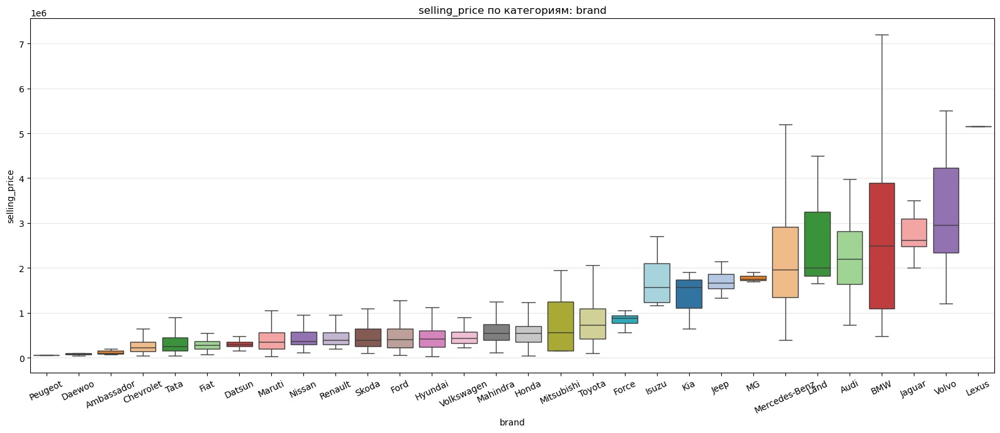

In [176]:
df_train['brand'] = X_train_new['brand']
plot_price_box_by_category(df_train, 'brand', figsize=(16, 7))

C:\Users\79104\AppData\Local\Temp\ipykernel_18804\4108912351.py:45: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


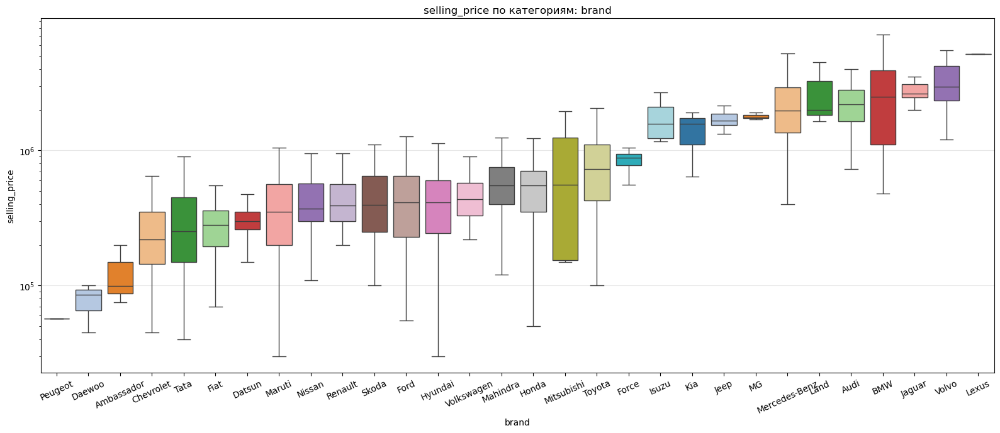

In [177]:
plot_price_box_by_category(df_train, 'brand', figsize=(16, 7),  log_y=True)

In [178]:
b = X_train_new['brand'].value_counts()
b

brand
Maruti           1803
Hyundai          1058
Mahindra          611
Tata              534
Toyota            309
Ford              308
Honda             308
Chevrolet         188
Renault           171
Volkswagen        153
Nissan             63
Skoda              61
Datsun             49
Mercedes-Benz      44
BMW                41
Fiat               39
Audi               31
Jeep               20
Mitsubishi          8
Volvo               8
Jaguar              7
Force               4
Isuzu               4
Land                3
Kia                 3
MG                  3
Ambassador          3
Daewoo              3
Lexus               1
Peugeot             1
Name: count, dtype: int64

Объединим более мелкие бренды в одну категорию 'others', а также выделим премиальные бренды

In [179]:
min_br = 10

rare = b[b < min_br].index

X_train_new['brand_grp'] = X_train_new['brand'].where(~X_train_new['brand'].isin(rare), 'other')
X_test_new['brand_grp']  = X_test_new['brand'].where(~X_test_new['brand'].isin(rare), 'other')

X_train_new['rare'] = (X_train_new['brand_grp'] == 'other').astype(int)
X_test_new['rare']  = (X_test_new['brand_grp'] == 'other').astype(int)

In [180]:
premium = {'Mercedes-Benz','BMW','Audi','Jaguar','Lexus','Volvo', 'Land'}

X_train_new['premium'] = X_train_new['brand'].isin(premium).astype(int)
X_test_new['premium']  = X_test_new['brand'].isin(premium).astype(int)

In [181]:
#дополнение к TE, name_count не будем включать в модель
train_name_counts = df_train['name'].value_counts()

X_train_new['name_count'] = df_train['name'].map(train_name_counts).fillna(0).astype(int)
X_test_new['name_count']  = df_test['name'].map(train_name_counts).fillna(0).astype(int)

X_train_new['log_name_count'] = np.log1p(X_train_new['name_count'])
X_test_new['log_name_count']  = np.log1p(X_test_new['name_count'])

X_train_new['name_unseen'] = (X_train_new['name_count'] == 0).astype(int)
X_test_new['name_unseen']  = (X_test_new['name_count'] == 0).astype(int)

In [182]:
#вычисляем возраст машины, чтобы использовать вмесо года
X_train_new['age'] = 2021 - df_train['year']
X_test_new['age'] = 2021 - df_test['year']

In [183]:
#логарифмируем признаки
X_train_new['log_km_driven'] = np.log1p(df_train['km_driven'])
X_train_new['log_max_power'] = np.log1p(df_train['max_power'])
X_train_new['log_torque_nm'] = np.log1p(df_train['torque_nm'])

X_test_new['log_km_driven'] = np.log1p(df_test['km_driven'])
X_test_new['log_max_power'] = np.log1p(df_test['max_power'])
X_test_new['log_torque_nm'] = np.log1p(df_test['torque_nm'])

X_train_new['log_km_per_year'] = X_train_new['log_km_driven'] / X_train_new['age']
X_test_new['log_km_per_year'] = X_test_new['log_km_driven'] / X_test_new['age']

In [184]:
owner = {
    'First Owner': 1,
    'Second Owner': 2,
    'Third Owner': 3,
    'Fourth & Above Owner': 4
}

X_train_new['is_test_drive'] = (df_train['owner'] == 'Test Drive Car').astype(int)
X_train_new['owner_n'] = df_train['owner'].map(owner).fillna(0).astype(int)
X_test_new['is_test_drive'] = (df_test['owner'] == 'Test Drive Car').astype(int)
X_test_new['owner_n'] = df_test['owner'].map(owner).fillna(0).astype(int)

In [185]:
X_train_new['age2'] = X_train_new['age']**2
X_test_new['age2'] = X_test_new['age']**2

In [186]:
X_train_new['engine_1'] = df_train['engine'] / 1000
X_test_new['engine_1'] = df_test['engine'] / 1000

In [187]:
aut = {
    'Manual': 0,
    'Automatic': 1
}

X_train_new['is_automatic'] = (df_train['transmission'] == 'Automatic').astype(int)
X_test_new['is_automatic'] = (df_test['transmission'] == 'Automatic').astype(int)

In [188]:
X_train_new.head()

,mileage_was_nan,engine_was_nan,max_power_was_nan,seats_was_nan,torque_nm_was_nan,max_torque_rpm_was_nan,brand,brand_grp,rare,premium,...,age,log_km_driven,log_max_power,log_torque_nm,log_km_per_year,is_test_drive,owner_n,age2,engine_1,is_automatic
0,0,0,0,0,0,0,Maruti,Maruti,0,0,...,7,11.887938,4.317488,5.252274,1.698277,0,1,49,1.248,0
1,0,0,0,0,0,0,Skoda,Skoda,0,0,...,7,11.695255,4.649378,5.525453,1.670751,0,2,49,1.498,0
2,0,0,0,0,0,0,Hyundai,Hyundai,0,0,...,11,11.751950,4.510859,5.396664,1.068359,0,1,121,1.396,0
3,0,0,0,0,0,0,Maruti,Maruti,0,0,...,14,11.695255,4.490881,4.734236,0.835375,0,1,196,1.298,0
4,0,0,0,0,0,0,Hyundai,Hyundai,0,0,...,4,10.714440,4.417152,4.742756,2.678610,0,1,16,1.197,0


In [189]:
X_train_new.columns

Index(['mileage_was_nan', 'engine_was_nan', 'max_power_was_nan',
       'seats_was_nan', 'torque_nm_was_nan', 'max_torque_rpm_was_nan', 'brand',
       'brand_grp', 'rare', 'premium', 'name_count', 'log_name_count',
       'name_unseen', 'age', 'log_km_driven', 'log_max_power', 'log_torque_nm',
       'log_km_per_year', 'is_test_drive', 'owner_n', 'age2', 'engine_1',
       'is_automatic'],
      dtype='object')

In [190]:
X_train_cat.columns

Index(['year', 'km_driven', 'mileage', 'engine', 'max_power', 'torque_nm',
       'max_torque_rpm', 'name_te', 'fuel_Diesel', 'fuel_LPG', 'fuel_Petrol',
       'seller_type_Individual', 'seller_type_Trustmark Dealer',
       'transmission_Manual', 'owner_Fourth & Above Owner',
       'owner_Second Owner', 'owner_Test Drive Car', 'owner_Third Owner',
       'seats_4', 'seats_5', 'seats_6', 'seats_7', 'seats_8', 'seats_9',
       'seats_10', 'seats_14'],
      dtype='object')

In [191]:
X_train_final = pd.concat([X_train_new, df_train[['mileage', 'max_torque_rpm', 'fuel', 'seller_type', 'seats']], X_train_cat['name_te']], axis=1)
X_test_final = pd.concat([X_test_new, df_test[['mileage', 'max_torque_rpm', 'fuel', 'seller_type', 'seats']], X_test_cat['name_te']], axis=1)

In [192]:
num_sc = ['mileage_was_nan', 'engine_was_nan', 'max_power_was_nan',
          'seats_was_nan', 'torque_nm_was_nan', 'max_torque_rpm_was_nan', 'rare', 'premium',
          'log_name_count', 'name_unseen', 'age', 'log_km_driven', 'log_max_power', 'log_torque_nm',
          'log_km_per_year', 'is_test_drive', 'owner_n', 'age2', 'engine_1', 'is_automatic', 'mileage', 'max_torque_rpm', 'name_te']
cat_en = ['brand_grp', 'fuel', 'seller_type', 'seats']

In [193]:
num_pip = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())
])

cat_pip = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent')),
    ('ohe', OneHotEncoder(drop='first', handle_unknown='ignore'))
])

preprocessing = ColumnTransformer(
    transformers=[
    ('num', num_pip, num_sc),
    ('cat', cat_pip, cat_en)
    ],
    remainder='drop',
    verbose_feature_names_out=False
)

In [194]:
cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_STATE)

pipe = Pipeline([
    ('preparation', preprocessing),
    ('model', Ridge())
])

models = {
    'Ridge': {
        'model': [Ridge()],
        'model__alpha': [0.000001, 0.00001, 0.0001, 0.001, 0.01, 0.1, 1, 5, 10, 20, 50, 100]
    },
    'Lasso': {
        'model': [Lasso()],
        'model__alpha': [0.000001, 0.00001, 0.0001, 0.001, 0.01, 0.1, 1, 5, 10, 20, 50, 100]
    },
    'ElasticNet': {
        'model': [ElasticNet()],
        'model__alpha': [0.000001, 0.00001, 0.0001, 0.001, 0.01, 0.1, 1, 5, 10, 20, 50, 100],
        'model__l1_ratio': [0.1, 0.3, 0.5, 0.7, 0.9]
    },
    'LinearRegression': {
        'model': [LinearRegression()]
    }
}

In [195]:
scoring = {
    'r2_log': 'r2',
    'rmse_log': 'neg_root_mean_squared_error'
}

rows = []
best_estimators = {}

for name, param_grid in models.items():
    gs = GridSearchCV(
        estimator=pipe,
        param_grid=param_grid,
        scoring=scoring,
        refit='r2_log',
        cv=cv,
        n_jobs=-1
    )
    gs.fit(X_train_final, y_log_train)

    best_estimators[name] = gs.best_estimator_
    best_idx = gs.best_index_

    mean_r2 = gs.cv_results_['mean_test_r2_log'][best_idx]
    mean_rmse = -gs.cv_results_['mean_test_rmse_log'][best_idx]

    rows.append({
        'model': name,
        'best_r2_log': float(mean_r2),
        'best_rmse_log': float(mean_rmse),
        'best_params': gs.best_params_,
        'refit_metric': gs.refit,
    })

In [196]:
res = pd.DataFrame(rows).sort_values('best_r2_log', ascending=False).reset_index(drop=True)
res

,model,best_r2_log,best_rmse_log,best_params,refit_metric
0,Ridge,0.898590,0.243075,"{'model': Ridge(), 'model__alpha': 1}",r2_log
1,ElasticNet,0.898579,0.243089,"{'model': ElasticNet(), 'model__alpha': 0.0001...",r2_log
2,Lasso,0.898564,0.243109,"{'model': Lasso(), 'model__alpha': 0.0001}",r2_log
3,LinearRegression,0.898468,0.243229,{'model': LinearRegression()},r2_log


In [197]:
ridge3 = best_estimators['Ridge']
y_pred_tr_ri3 = ridge3.predict(X_train_final)
y_pred_te_ri3 = ridge3.predict(X_test_final)

log_met(y_train, y_pred_tr_ri3, y_test, y_pred_te_ri3)

For train:
MSE: 32145095373.33
RMSE: 179290.53
r2: 0.888

For test:
MSE: 58386842554.14
RMSE: 241633.69
r2: 0.898


C:\Users\79104\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:246: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [198]:
rid3 = ridge3.named_steps['model']
prep = ridge3.named_steps['preparation']

feature_names = prep.get_feature_names_out()
a = pd.DataFrame({
    'feature': feature_names,
    'coef': rid3.coef_,
    'abs_coef': np.abs(rid3.coef_)
}).sort_values('abs_coef', ascending=False).reset_index(drop=True)
a

,feature,coef,abs_coef
0,age,-0.766229,0.766229
1,brand_grp_Toyota,0.327912,0.327912
2,brand_grp_Jeep,0.304094,0.304094
3,age2,0.293134,0.293134
4,brand_grp_Tata,-0.263607,0.263607
5,brand_grp_Datsun,-0.215498,0.215498
6,brand_grp_Chevrolet,-0.209857,0.209857
7,fuel_Diesel,0.178573,0.178573
8,log_max_power,0.177115,0.177115
9,brand_grp_BMW,0.158635,0.158635


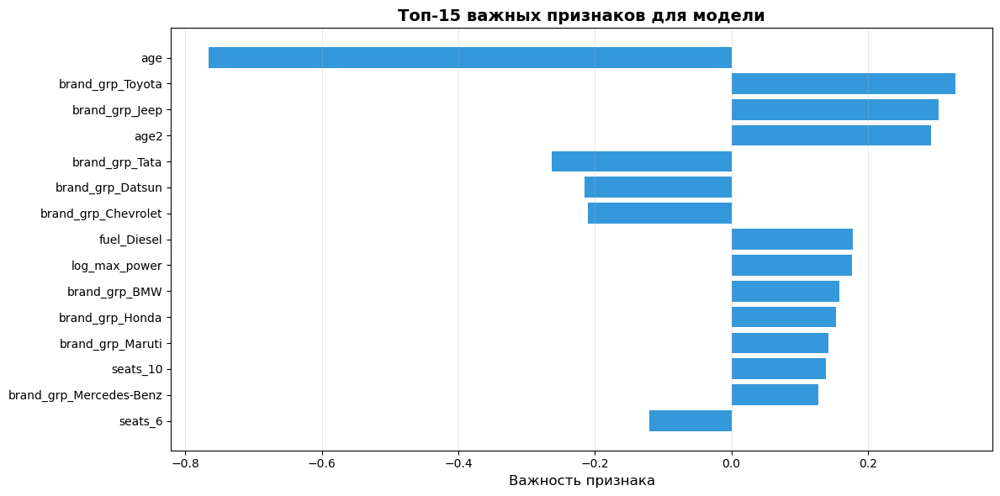

In [199]:
plt.figure(figsize=(12, 6))
top_features = a.head(15)
plt.barh(range(len(top_features)), top_features['coef'], color='#3498db')
plt.yticks(range(len(top_features)), top_features['feature'])
plt.xlabel('Важность признака', fontsize=12)
plt.title('Топ-15 важных признаков для модели', fontsize=14, fontweight='bold')
plt.gca().invert_yaxis()
plt.grid(axis='x', alpha=0.3)
plt.tight_layout()
plt.show()

**Вывод**
- качество всех моделей довольно высокое, отличается на десятитысячные или стотысячные
- была определена как лучшая модель ridge с силой регуляризации 1
- наибольшее влияние оказали возраст машины, а также определенные бренды и мощность машины

# **Часть 4. | Бизнесовая (0.5 балла)**

### **Задание 23 (0.25 балла)**

В мире бизнеса очень важно давать оценку качества модели понятную бизнесу, поэтому иногда заказчики приходят с кастомными метриками. Попробуем сделать такую для нашей задачи.

**Описание метрики:**

Среди всех предсказанных цен на авто нужно посчитать долю прогнозов, отличающихся от реальных цен на эти авто не более чем на 10% (в одну или другую сторону)

**Ваша задача:**

- [x] Реализуйте метрику `business_metric`
- [x] Посчитайте метрику для всех обученных моделей и определеите, какаю лучше всего решает задачу бизнеса

In [200]:
def business_metrics(y_true, y_pred, tot: float = 0.1):
    y_true = np.asarray(y_true, dtype=float)
    y_pred = np.asarray(y_pred, dtype=float)
    rel_err = np.abs(y_pred - y_true) / y_true
    
    return float(np.mean(rel_err <= tot))

In [201]:
def business_metric_from_log(y_true_log, y_pred_log, tot: float = 0.10) -> float:
    y_true = np.expm1(np.asarray(y_true_log, dtype=float))
    y_pred = np.expm1(np.asarray(y_pred_log, dtype=float))
    return business_metrics(y_true, y_pred, tot=tot)

In [202]:
#linreg
lr1 = business_metrics(y_test, y_pred_te_lr)
#linreg scaled
lr2 = business_metrics(y_test, y_pred_te_lr2)
#lasso
la = business_metrics(y_test, y_pred_te_la)
#lasso with GS alpha
la2 = business_metrics(y_test, y_pred_te_la2)
#elastic
el = business_metrics(y_test, y_pred_te_el)
#l0 reg
l0 = business_metrics(y_test, y_pred_te_l0)
#ridge
ri = business_metrics(y_test, y_pred_te_ri)
#ridge log
ri2 = business_metric_from_log(y_log_test, y_pred_te)
#ridge new features 
ri3 = business_metric_from_log(y_log_test, y_pred_te_ri3)

In [203]:
metrics = pd.DataFrame({
    'model': [
        'LinearRegression',
        'LinearRegression scaled',
        'Lasso',
        'Lasso GridSearch alpha',
        'ElasticNet',
        'L0 regularization',
        'Ridge',
        'Ridge log-target',
        'Ridge Pipeline'
    ],
    'business_metric': [
        lr1,
        lr2,
        la,
        la2,
        el,
        l0,
        ri,
        ri2,
        ri3
    ]
}).sort_values('business_metric', ascending=False).reset_index(drop=True)

metrics

,model,business_metric
0,Ridge Pipeline,0.389
1,Ridge log-target,0.349
2,Lasso GridSearch alpha,0.255
3,ElasticNet,0.248
4,L0 regularization,0.244
5,LinearRegression,0.239
6,Lasso,0.239
7,LinearRegression scaled,0.239
8,Ridge,0.231


Лучшей оказалась модель ridge, но ее показатель все равно довольно низкий, около 39%

Попробуем адаптировать модель под созданную метрику и расчитать наиболее подходящую нам модель по ней

In [204]:
business_scorer = make_scorer(business_metric_from_log, greater_is_better=True, tot=0.10)

scoring_bus = {
    'r2_log': 'r2',
    'rmse_log': 'neg_root_mean_squared_error',
    'business': business_scorer
    
}

rows = []
best_estimators = {}

for name, param_grid in models.items():
    gs = GridSearchCV(
        estimator=pipe,
        param_grid=param_grid,
        scoring=scoring_bus,
        refit='business',
        cv=cv,
        n_jobs=-1
    )
    gs.fit(X_train_final, y_log_train)

    best_estimators[name] = gs.best_estimator_
    best_idx = gs.best_index_

    mean_r2 = gs.cv_results_['mean_test_r2_log'][best_idx]
    mean_rmse = -gs.cv_results_['mean_test_rmse_log'][best_idx]
    mean_bus = gs.cv_results_['mean_test_business'][best_idx]

    rows.append({
        'model': name,
        'best_r2_log': float(mean_r2),
        'best_rmse_log': float(mean_rmse),
        'best_business_score': float(mean_bus),
        'best_params': gs.best_params_,
        'refit_metric': gs.refit,
    })

In [205]:
res_bus = pd.DataFrame(rows).sort_values('best_business_score', ascending=False).reset_index(drop=True)
res_bus

,model,best_r2_log,best_rmse_log,best_business_score,best_params,refit_metric
0,Ridge,0.898047,0.243736,0.356223,"{'model': Ridge(), 'model__alpha': 10}",business
1,ElasticNet,0.897206,0.244739,0.355881,"{'model': ElasticNet(), 'model__alpha': 0.001,...",business
2,Lasso,0.896490,0.245597,0.355539,"{'model': Lasso(), 'model__alpha': 0.001}",business
3,LinearRegression,0.898468,0.243229,0.354342,{'model': LinearRegression()},business


In [206]:
ridge4 = best_estimators['Ridge']
y_pred_tr_ri4 = ridge4.predict(X_train_final)
y_pred_te_ri4 = ridge4.predict(X_test_final)

print(log_met(y_train, y_pred_tr_ri4, y_test, y_pred_te_ri4))
business_metric_from_log(y_log_test, y_pred_te_ri4)

For train:
MSE: 32283850653.08
RMSE: 179677.07
r2: 0.887

For test:
MSE: 59657815623.8
RMSE: 244249.49
r2: 0.896
None


C:\Users\79104\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:246: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


0.385

Данная модель оказалась не лучше, чем предыдущая, если описаться на метрику бизнеса

### **Задание 24 (0.25 балла)**

Но у бизнеса не всегда есть идеи и иногда задача на выбор метрики делегируется вам.

**Задание:**

- [x] Придумайте и реализуйте другую кастомную метрику с учетом того, что модель не должна сильно ошибаться в прогнозе, но недопрогноз для модели, согласно мнению бизнеса, хуже, чем перепрогноз.
- [x] Посчитайте метрику для всех обученных моделей и определеите, какаю лучше всего решает задачу бизнеса



In [207]:
def your_business_metrics(y_true, y_pred, w_under = 2, w_over = 1):
    y_true = np.asarray(y_true, dtype=float)
    y_pred = np.asarray(y_pred, dtype=float)

    met = (y_pred - y_true) / y_true
    w = np.where(met < 0, w_under, w_over)
    return float(np.mean(w * met**2)**0.5) #то есть штраф будет в 2 раза больше за недопрогноз

def your_log_met(y_true_log, y_pred_log, w_under = 2, w_over = 1):
    y_true = np.expm1(np.asarray(y_true_log, dtype=float))
    y_pred = np.expm1(np.asarray(y_pred_log, dtype=float))
    return your_business_metrics(y_true, y_pred, w_under=w_under, w_over=w_over)

In [208]:
#linreg
lr1 = your_business_metrics(y_test, y_pred_te_lr)
#linreg scaled
lr2 = your_business_metrics(y_test, y_pred_te_lr2)
#lasso
la = your_business_metrics(y_test, y_pred_te_la)
#lasso with GS alpha
la2 = your_business_metrics(y_test, y_pred_te_la2)
#elastic
el = your_business_metrics(y_test, y_pred_te_el)
#l0 reg
l0 = your_business_metrics(y_test, y_pred_te_l0)
#ridge
ri = your_business_metrics(y_test, y_pred_te_ri)
#ridge log
ri2 = your_log_met(y_log_test, y_pred_te)
#ridge new features 
ri3 = your_log_met(y_log_test, y_pred_te_ri3)

In [209]:
metrics2 = pd.DataFrame({
    'model': [
        'LinearRegression',
        'LinearRegression scaled',
        'Lasso',
        'Lasso GridSearch alpha',
        'ElasticNet',
        'L0 regularization',
        'Ridge',
        'Ridge log-target',
        'Ridge Pipeline'
    ],
    'business_metric': [
        lr1,
        lr2,
        la,
        la2,
        el,
        l0,
        ri,
        ri2,
        ri3
    ]
}).sort_values('business_metric', ascending=True).reset_index(drop=True)

metrics2

,model,business_metric
0,Ridge Pipeline,0.294896
1,Ridge log-target,0.378931
2,Ridge,1.375697
3,ElasticNet,1.546686
4,Lasso GridSearch alpha,1.720182
5,L0 regularization,1.885150
6,Lasso,1.888940
7,LinearRegression,1.888940
8,LinearRegression scaled,1.888940


Тут также выигрывает новая модель с новыми признаками, причем с заметным отрывом, попробуем подобрать модель также по этой метрике через GridSearch

In [210]:
your_score = make_scorer(your_log_met, greater_is_better=False, w_under=2,w_over=1)

scoring_bus = {
    'r2_log': 'r2',
    'rmse_log': 'neg_root_mean_squared_error',
    'your_score': your_score
    
}

rows = []
best_estimators = {}

for name, param_grid in models.items():
    gs = GridSearchCV(
        estimator=pipe,
        param_grid=param_grid,
        scoring=scoring_bus,
        refit='your_score',
        cv=cv,
        n_jobs=-1
    )
    gs.fit(X_train_final, y_log_train)

    best_estimators[name] = gs.best_estimator_
    best_idx = gs.best_index_

    mean_r2 = gs.cv_results_['mean_test_r2_log'][best_idx]
    mean_rmse = -gs.cv_results_['mean_test_rmse_log'][best_idx]
    mean_your = -gs.cv_results_['mean_test_your_score'][best_idx]

    
    rows.append({
        'model': name,
        'best_r2_log': float(mean_r2),
        'best_rmse_log': float(mean_rmse),
        'best_your_score': float(mean_your),
        'best_params': gs.best_params_,
        'refit_metric': gs.refit,
    })

In [211]:
res_your = pd.DataFrame(rows).sort_values('best_your_score').reset_index(drop=True)
res_your

,model,best_r2_log,best_rmse_log,best_your_score,best_params,refit_metric
0,ElasticNet,0.898579,0.243089,0.301825,"{'model': ElasticNet(), 'model__alpha': 0.0001...",your_score
1,Ridge,0.898590,0.243075,0.301846,"{'model': Ridge(), 'model__alpha': 1}",your_score
2,Lasso,0.898564,0.243109,0.301850,"{'model': Lasso(), 'model__alpha': 0.0001}",your_score
3,LinearRegression,0.898468,0.243229,0.302021,{'model': LinearRegression()},your_score


In [212]:
el2 = best_estimators['ElasticNet']
y_pred_tr_el2 = el2.predict(X_train_final)
y_pred_te_el2 = el2.predict(X_test_final)

print(log_met(y_train, y_pred_tr_el2, y_test, y_pred_te_el2))
business_metric_from_log(y_log_test, y_pred_te_el2)

For train:
MSE: 32230432052.91
RMSE: 179528.36
r2: 0.888

For test:
MSE: 57535017567.64
RMSE: 239864.58
r2: 0.9
None


C:\Users\79104\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:246: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


0.378

В данном случае модель, которая была определена изначально по gridsearch показала результат лучше на тестовых данных

#### **Вывод**

Таким образом, наилучшей моделью по всем используемым метрикам оказалась моедель `Ridge` с `alpha=1`

# **<font color="green">Часть 5 | Создание интерактивного приложения на Streamlit (3 балла)</font>**

Вам необходимо создать интерактивное приложение на Streamlit, которое будет:

- Показывать основные информативные графики/гистограммы в рамках EDA (1 балл)
- На вход запрашивать csv-файл с признаками объектов или запрашивать признаки объекта в окошках для ввода, и применять на поступивших объектах модель (1 балл)
- Визуализировать веса обученной модели (1 балл)

Сохраним обученную модель в pickle-файл

In [213]:
model_dir = 'models'
os.makedirs(model_dir, exist_ok=True)

In [214]:
X_train_final.columns

Index(['mileage_was_nan', 'engine_was_nan', 'max_power_was_nan',
       'seats_was_nan', 'torque_nm_was_nan', 'max_torque_rpm_was_nan', 'brand',
       'brand_grp', 'rare', 'premium', 'name_count', 'log_name_count',
       'name_unseen', 'age', 'log_km_driven', 'log_max_power', 'log_torque_nm',
       'log_km_per_year', 'is_test_drive', 'owner_n', 'age2', 'engine_1',
       'is_automatic', 'mileage', 'max_torque_rpm', 'fuel', 'seller_type',
       'seats', 'name_te'],
      dtype='object')

Создадим пайплайн, который сразу будет обрабатывать признаки, которые будут запрашены в окошках для ввода, изначальные признаки необходимо обработать, а также создать новые признаки из старых, учтем, что лучший результат получается при логарифмированной целевой переменной, также включим данный шаг в пайплайн

In [215]:
#сделано при помощи llm

# -------- 1) Feature engineering (включая OOF Target Encoding для train) --------

class CarFeatureEngineer(BaseEstimator, TransformerMixin):
    """
    Делает:
      - *_was_nan для: mileage, engine, max_power, seats, torque_nm, max_torque_rpm
      - brand = first token из name, brand_grp (rare->other), rare, premium
      - age=2021-year, age2
      - log_km_driven/log_max_power/log_torque_nm (log1p)
      - log_km_per_year = log_km_driven / age
      - is_test_drive, owner_n
      - engine_1 = engine/1000
      - is_automatic
      - name_count/log_name_count/name_unseen
      - name_te через TargetEncoder на log1p(y), с OOF для train (5-fold, rs=42)
    """

    def __init__(
        self,
        ref_year: int = 2021,
        min_brand_count: int = 10,
        te_min_samples_leaf: int = 200,
        te_smoothing: float = 50.0,
        te_n_splits: int = 5,
        random_state: int = 42,
        premium_brands=None,
    ):
        self.ref_year = ref_year
        self.min_brand_count = min_brand_count
        self.te_min_samples_leaf = te_min_samples_leaf
        self.te_smoothing = te_smoothing
        self.te_n_splits = te_n_splits
        self.random_state = random_state
        self.premium_brands = premium_brands or {
            "Mercedes-Benz", "BMW", "Audi", "Jaguar", "Lexus", "Volvo", "Land"
        }

        self.na_cols_ = ["mileage", "engine", "max_power", "seats", "torque_nm", "max_torque_rpm"]
        self.owner_map_ = {
            "First Owner": 1,
            "Second Owner": 2,
            "Third Owner": 3,
            "Fourth & Above Owner": 4
        }

    @staticmethod
    def _as_str(s: pd.Series) -> pd.Series:
        return s.fillna("").astype(str)

    @staticmethod
    def _brand_from_name(name: pd.Series) -> pd.Series:
        return (
            name.fillna("")
                .astype(str)
                .str.strip()
                .str.split()
                .str[0]
                .fillna("")
        )

    @staticmethod
    def _to_num(s: pd.Series) -> pd.Series:
        return pd.to_numeric(s, errors="coerce")

    def fit(self, X: pd.DataFrame, y):
        X = X.copy()

        # --- brand rarity ---
        name = self._as_str(X.get("name", pd.Series([""] * len(X), index=X.index)))
        brand = self._brand_from_name(name)
        brand_counts = brand.value_counts()
        self.rare_brands_ = set(brand_counts[brand_counts < self.min_brand_count].index.tolist())

        # --- name counts ---
        self.name_counts_ = name.value_counts().to_dict()

        # --- TargetEncoder fitted on ALL train using log1p(y) (для inference) ---
        y_log = np.log1p(np.asarray(y, dtype=float))
        self.te_all_ = TargetEncoder(
            cols=["name"],
            min_samples_leaf=self.te_min_samples_leaf,
            smoothing=self.te_smoothing
        )
        self.te_all_.fit(pd.DataFrame({"name": name}), y_log)

        return self

    def _build_deterministic_features(self, X: pd.DataFrame) -> pd.DataFrame:
        X = X.copy()
        out = pd.DataFrame(index=X.index)

        # raw cols
        name = self._as_str(X.get("name", pd.Series([""] * len(X), index=X.index)))
        year = self._to_num(X.get("year", np.nan))
        km = self._to_num(X.get("km_driven", np.nan))
        mileage = self._to_num(X.get("mileage", np.nan))
        engine = self._to_num(X.get("engine", np.nan))
        max_power = self._to_num(X.get("max_power", np.nan))
        torque_nm = self._to_num(X.get("torque_nm", np.nan))
        max_torque_rpm = self._to_num(X.get("max_torque_rpm", np.nan))
        seats = self._to_num(X.get("seats", np.nan))

        fuel = self._as_str(X.get("fuel", pd.Series([""] * len(X), index=X.index)))
        seller_type = self._as_str(X.get("seller_type", pd.Series([""] * len(X), index=X.index)))
        transmission = self._as_str(X.get("transmission", pd.Series([""] * len(X), index=X.index)))
        owner = self._as_str(X.get("owner", pd.Series([""] * len(X), index=X.index)))

        # was_nan flags
        for c, s in [
            ("mileage", mileage),
            ("engine", engine),
            ("max_power", max_power),
            ("seats", seats),
            ("torque_nm", torque_nm),
            ("max_torque_rpm", max_torque_rpm),
        ]:
            out[f"{c}_was_nan"] = s.isna().astype(int)

        # brand_grp / rare / premium
        brand = self._brand_from_name(name)
        out["brand_grp"] = brand.where(~brand.isin(self.rare_brands_), "other")
        out["rare"] = (out["brand_grp"] == "other").astype(int)
        out["premium"] = brand.isin(self.premium_brands).astype(int)

        # age / age2
        out["age"] = self.ref_year - year
        out["age2"] = out["age"] ** 2

        # logs (log1p), clip <0 to 0 for safety
        out["log_km_driven"] = np.log1p(km.clip(lower=0))
        out["log_max_power"] = np.log1p(max_power.clip(lower=0))
        out["log_torque_nm"] = np.log1p(torque_nm.clip(lower=0))

        # log_km_per_year = log_km_driven / age
        out["log_km_per_year"] = out["log_km_driven"] / out["age"]

        # owner features
        out["is_test_drive"] = (owner == "Test Drive Car").astype(int)
        out["owner_n"] = owner.map(self.owner_map_).fillna(0).astype(int)

        # engine_1
        out["engine_1"] = engine / 1000.0

        # is_automatic
        out["is_automatic"] = (transmission == "Automatic").astype(int)

        # name_count, log_name_count, name_unseen
        name_count = name.map(self.name_counts_).fillna(0).astype(int)
        out["log_name_count"] = np.log1p(name_count)
        out["name_unseen"] = (name_count == 0).astype(int)

        # raw numeric used directly in model
        out["mileage"] = mileage
        out["max_torque_rpm"] = max_torque_rpm

        # categorical cols used directly
        out["fuel"] = fuel
        out["seller_type"] = seller_type
        out["seats"] = seats

        # убрать inf (например, если year=2021 => age=0)
        out = out.replace([np.inf, -np.inf], np.nan)

        return out

    def fit_transform(self, X: pd.DataFrame, y):
        # 1) fit (учим редкие бренды, name_counts, te_all)
        self.fit(X, y)

        # 2) deterministic features
        out = self._build_deterministic_features(X)

        # 3) OOF Target Encoding для name_te
        name = self._as_str(X.get("name", pd.Series([""] * len(X), index=X.index)))
        y_log = np.log1p(np.asarray(y, dtype=float))

        oof = np.full(len(out), np.nan, dtype=float)
        kf = KFold(n_splits=self.te_n_splits, shuffle=True, random_state=self.random_state)

        name_df = pd.DataFrame({"name": name})
        for tr_idx, val_idx in kf.split(name_df):
            te = TargetEncoder(
                cols=["name"],
                min_samples_leaf=self.te_min_samples_leaf,
                smoothing=self.te_smoothing
            )
            te.fit(name_df.iloc[tr_idx], y_log[tr_idx])
            oof[val_idx] = te.transform(name_df.iloc[val_idx])["name"].astype(float).values

        # если вдруг где-то NaN (редко) — подставим te_all
        if np.isnan(oof).any():
            oof[np.isnan(oof)] = self.te_all_.transform(name_df)["name"].astype(float).values[np.isnan(oof)]

        out["name_te"] = oof
        return out

    def transform(self, X: pd.DataFrame) -> pd.DataFrame:
        out = self._build_deterministic_features(X)

        name = self._as_str(X.get("name", pd.Series([""] * len(X), index=X.index)))
        name_df = pd.DataFrame({"name": name})
        out["name_te"] = self.te_all_.transform(name_df)["name"].astype(float).values

        return out


# -------- 2) Списки фичей --------

num_sc = [
    "mileage_was_nan", "engine_was_nan", "max_power_was_nan",
    "seats_was_nan", "torque_nm_was_nan", "max_torque_rpm_was_nan",
    "rare", "premium",
    "log_name_count", "name_unseen",
    "age", "log_km_driven", "log_max_power", "log_torque_nm",
    "log_km_per_year", "is_test_drive", "owner_n",
    "age2", "engine_1", "is_automatic",
    "mileage", "max_torque_rpm", "name_te",
]
cat_en = ["brand_grp", "fuel", "seller_type", "seats"]


# -------- 3) Preprocessing + модель с TransformedTargetRegressor --------

num_pip = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="median")),
    ("scaler", StandardScaler()),
])

cat_pip = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="most_frequent")),
    ("ohe", OneHotEncoder(drop="first", handle_unknown="ignore")),
])

preprocessing = ColumnTransformer(
    transformers=[
        ("num", num_pip, num_sc),
        ("cat", cat_pip, cat_en),
    ],
    remainder="drop",
    verbose_feature_names_out=False,
)

model = TransformedTargetRegressor(
    regressor=Ridge(alpha=1.0),
    func=np.log1p,
    inverse_func=np.expm1,
)

full_pipe = Pipeline(steps=[
    ("features", CarFeatureEngineer(ref_year=2021)),
    ("preparation", preprocessing),
    ("model", model),
])

In [216]:
df_train_nan.columns

Index(['name', 'year', 'km_driven', 'fuel', 'seller_type', 'transmission',
       'owner', 'mileage', 'engine', 'max_power', 'seats', 'torque_nm',
       'max_torque_rpm', 'selling_price'],
      dtype='object')

In [218]:
df_train_raw = df_train_nan.drop('selling_price', axis=1)
raw_cols = df_train_raw.columns.tolist()
raw_cols

['name',
 'year',
 'km_driven',
 'fuel',
 'seller_type',
 'transmission',
 'owner',
 'mileage',
 'engine',
 'max_power',
 'seats',
 'torque_nm',
 'max_torque_rpm']

In [219]:
full_pipe.fit(df_train_raw, y_train)

Pipeline(steps=[('features',
                 CarFeatureEngineer(premium_brands={'Audi', 'BMW', 'Jaguar',
                                                    'Land', 'Lexus',
                                                    'Mercedes-Benz',
                                                    'Volvo'})),
                ('preparation',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  ['mileage_was_nan',
                                                   'engine_was_nan',
                                                   'max_power_was_nan',
                                                   'seats_was_nan',
                                                   'torqu...
                                                   'max_torque_rpm',
                                                   'name_te']),
                                                 ('cat',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('ohe',
                                                                   OneHotEncoder(drop='first',
                                                                                 handle_unknown='ignore'))]),
                                                  ['brand_grp', 'fuel',
                                                   'seller_type', 'seats'])],
                                   verbose_feature_names_out=False)),
                ('model',
                 TransformedTargetRegressor(func=<ufunc 'log1p'>,
                                            inverse_func=<ufunc 'expm1'>,
                                            regressor=Ridge()))])

In [220]:
final_feature_names = full_pipe.named_steps['preparation'].get_feature_names_out()

In [223]:
model_path = os.path.join(model_dir, 'full_pipe.pkl')

with open(model_path, 'wb') as f:
    pickle.dump(full_pipe, f, protocol=pickle.HIGHEST_PROTOCOL)
print(f'Пайплайн сохранен: {model_path}')

raw_feature_names_path = os.path.join(model_dir, 'raw_feature_names.pkl')
with open(raw_feature_names_path, 'wb') as f:
    pickle.dump(raw_cols, f, protocol=pickle.HIGHEST_PROTOCOL)
print(f'Первоначальные колонки сохранены: {raw_feature_names_path}')

final_feature_names_path = os.path.join(model_dir, 'final_feature_names.pkl')
with open(final_feature_names_path, 'wb') as f:
    pickle.dump(final_feature_names, f, protocol=pickle.HIGHEST_PROTOCOL)
print(f'Итоговые колонки сохранены: {final_feature_names_path}')

Пайплайн сохранен: models\full_pipe.pkl
Первоначальные колонки сохранены: models\raw_feature_names.pkl
Итоговые колонки сохранены: models\final_feature_names.pkl


In [226]:
df_test_raw = df_test_nan.drop('selling_price', axis=1)

In [233]:
#тест на одном примере
with open(model_path, 'rb') as f:
    loaded_model = pickle.load(f)

test_sample = df_test_raw.iloc[0:1]
pred = loaded_model.predict(test_sample)
print(f'истинное значение: {y_test.iloc[0]}, предсказанное значение: {pred[0]}')

истинное значение: 229999, предсказанное значение: 389086.7084574632


In [234]:
predict = loaded_model.predict(df_test_raw)
mse_te = MSE(y_test, predict)
r2_te = r2_score(y_test, predict)

print('MSE:', round(mse_te, 2))
print('RMSE:', round(mse_te**0.5, 2))
print('r2:', round(r2_te, 3))

MSE: 58386858003.79
RMSE: 241633.73
r2: 0.898


C:\Users\79104\anaconda3\Lib\site-packages\sklearn\preprocessing\_encoders.py:246: UserWarning: Found unknown categories in columns [0] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


Метрики совпадают с метриками модели ridge3

# **Часть 6 | Оформление репозитория и оценка сервиса (2 балла)**

**Результаты вашей работы** необходимо разместить в своём GitHub-репозитории. В этот же репозиторий позже будет добавлена вторая часть.

Под результатами первой части понимаем следующее:

---

### Обязательные файлы:

1. **`.ipynb`-ноутбук** со всеми экспериментами:

   * полный EDA,
   * все шаги препроцессинга,
   * обучение и сравнение моделей,
   * сохранённые output’ы.

2. **`.pickle`-файл**, содержащий:

   * обученную модель (или пайплайн `scaler + model`);
   * параметры скейлинга;
   * любые числовые объекты, необходимые для инференса внутри Streamlit-приложения.

3. **`.md`-файл с выводами** о проделанной работе:

   * что было сделано (краткое описание каждого этапа);
   * какие результаты были получены (метрики + интерпретация);
   * что дало наибольший прирост качества;
   * что сделать не удалось и почему (это нормально и даже полезно);
   * **оценка разработанного сервиса**:

     * насколько приложение удобно в использовании;
     * что получилось визуализировать хорошо, а что — менее удачно;
     * какие ограничения или проблемы вы заметили;
     * какие улучшения планируете в следующей итерации.

По результатам второй части, ждем:

4. **Streamlit-приложение** (например, `app.py`), которое можно запустить командой:

   ```bash
   streamlit run app.py
   ```

В приложении должно быть:

* отображение ключевых графиков EDA;
* ввод данных (CSV или ручной ввод);
* применение модели;
* визуализация весов/коэффициентов.

**И ссылку на приложение в StreamlitHub.**


### **За что могут быть сняты баллы:**

* отсутствие `.pickle` с моделью / пайплайном;
* слабая или неполная аналитика в `.md`-файле;
* беспорядок в ноутбуке или неясная логика вычислений;
* отсутствие возможности запустить Streamlit-приложение.